Здесь попробуем обучить автоэнкодер для предсказания маски для каждого из классов (генерация см в `Autoencoder_data_generation.ipynb`)

In [1]:
import pickle
import keras
import os
import numpy as np
import cv2
import matplotlib.pyplot as plt

Using TensorFlow backend.


### Загружаем датасет и приводим его к нужному виду

(Возможно, всё-таки придётся использовать генератор, чтобы не пихать всё в один массивчик)

In [2]:
with open('../dataset/train_val_test_split.pickle', 'rb') as f:
    train_val_test = pickle.load(f)

In [3]:
train_filenames = train_val_test['train']
validate_filenames = train_val_test['validate']
test_filenames = train_val_test['test']

`https://stanford.edu/~shervine/blog/keras-how-to-generate-data-on-the-fly`

In [4]:
maps_folder = '../dataset/map/'
satellites_folder = '../dataset/satellite/'
masks_folder = '../dataset/masks/'

In [5]:
class DataGenerator(keras.utils.Sequence):
    
    def __init__(self, list_IDs, X_path='../dataset/map/', Y_path='../dataset/masks/', classid=0,
                 batch_size=32, dim=(300,400), shuffle=True):
        'Initialization'
        self.list_IDs = list_IDs
        self.X_path=X_path
        self.Y_path=Y_path
        self.classid = classid
        self.batch_size = batch_size
        self.dim = dim
        self.shuffle = shuffle
        self.on_epoch_end()
        
        
    def on_epoch_end(self):
        'Updates indexes after each epoch'
        self.indexes = np.arange(len(self.list_IDs))
        if self.shuffle == True:
            np.random.shuffle(self.indexes)
        
        
    def __data_generation(self, list_IDs_temp):
        'Generates data containing batch_size samples' # X : (n_samples, *dim, n_channels)
        # Initialization
        X = np.empty((self.batch_size, *self.dim, 3))
        Y = np.empty((self.batch_size, *self.dim, 1))

        # Generate data
        for i, ID in enumerate(list_IDs_temp):
            # Store sample
            X[i,] = cv2.imread(os.path.join(self.X_path, ID + '.png')) / 255.
            Y[i,] = (np.load(os.path.join(self.Y_path, ID + '.npy'))[self.classid]).reshape((*self.dim, 1))

        return X, Y
    
    
    def __len__(self):
        'Denotes the number of batches per epoch'
        return int(np.floor(len(self.list_IDs) / self.batch_size))
    
    
    def __getitem__(self, index):
        'Generate one batch of data'
        # Generate indexes of the batch
        indexes = self.indexes[index*self.batch_size:(index+1)*self.batch_size]

        # Find list of IDs
        list_IDs_temp = [self.list_IDs[k] for k in indexes]

        # Generate data
        X, Y = self.__data_generation(list_IDs_temp)

        return X, Y

In [6]:
training_generator_map_wood = DataGenerator(
    train_filenames,
    X_path=maps_folder,
    Y_path=masks_folder,
    classid=0,
    batch_size=10
)

validation_generator_map_wood = DataGenerator(
    validate_filenames,
    X_path=maps_folder,
    Y_path=masks_folder,
    classid=0,
    batch_size=10
)

In [7]:
x, y = training_generator_map_wood.__getitem__(0)

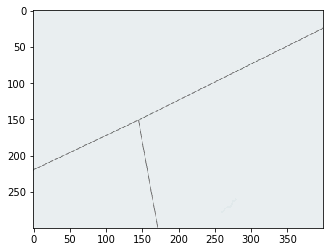

In [8]:
plt.imshow(x[5])

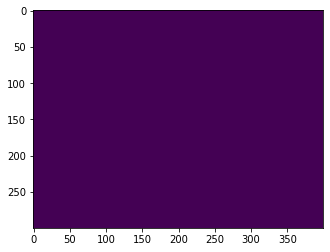

In [9]:
plt.imshow(y[5].reshape((300, 400)))

### Попробуем обучить модельку

In [6]:
from keras.layers import Input, Dense, Conv2D, MaxPooling2D, UpSampling2D
from keras.models import Model
from keras import backend as K
from keras.callbacks import EarlyStopping, ModelCheckpoint

In [11]:
input_img = Input(shape=(300, 400, 3))

In [12]:
# Model Construction
x = Conv2D(32, (3, 3), activation='relu', padding='same')(input_img)
x = MaxPooling2D((2, 2), padding='same')(x)
x = Conv2D(32, (3, 3), activation='relu', padding='same')(x)
encoded = MaxPooling2D((2, 2), padding='same')(x)
# At this point the representation is (7, 7, 32)
x = Conv2D(32, (3, 3), activation='relu', padding='same')(encoded)
x = UpSampling2D((2, 2))(x)
x = Conv2D(32, (3, 3), activation='relu', padding='same')(x)
x = UpSampling2D((2, 2))(x)
decoded = Conv2D(1, (3, 3), activation='sigmoid', padding='same')(x)
autoencoder = Model(input_img, decoded)
autoencoder.compile(optimizer='adam', loss='binary_crossentropy')






Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where


In [13]:
autoencoder.summary()

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         (None, 300, 400, 3)       0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 300, 400, 32)      896       
_________________________________________________________________
max_pooling2d_1 (MaxPooling2 (None, 150, 200, 32)      0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 150, 200, 32)      9248      
_________________________________________________________________
max_pooling2d_2 (MaxPooling2 (None, 75, 100, 32)       0         
_________________________________________________________________
conv2d_3 (Conv2D)            (None, 75, 100, 32)       9248      
_________________________________________________________________
up_sampling2d_1 (UpSampling2 (None, 150, 200, 32)      0         
__________

In [14]:
early_stopping = EarlyStopping(monitor='val_loss', mode='min', verbose=1, patience=3)
model_checkpoint = ModelCheckpoint('AUTOENCODER_MODEL/best_model_wood.h5', monitor='val_loss', mode='min', save_best_only=True)

In [15]:
autoencoder.fit_generator(
    generator=training_generator_map_wood,
    validation_data=validation_generator_map_wood,
    use_multiprocessing=True,
    workers=6,
    epochs=200,
    callbacks=[early_stopping, model_checkpoint]
)




Epoch 1/200





1310/1310 [==============================] - 1005s 767ms/step - loss: 0.1988 - val_loss: 0.2036
Epoch 2/200
1310/1310 [==============================] - 991s 757ms/step - loss: 0.1879 - val_loss: 0.1878
Epoch 3/200
1310/1310 [==============================] - 997s 761ms/step - loss: 0.1788 - val_loss: 0.1799
Epoch 4/200
1310/1310 [==============================] - 992s 757ms/step - loss: 0.1775 - val_loss: 0.1752
Epoch 5/200
1310/1310 [==============================] - 995s 760ms/step - loss: 0.1755 - val_loss: 0.1723
Epoch 6/200
1310/1310 [==============================] - 994s 758ms/step - loss: 0.1759 - val_loss: 0.1891
Epoch 7/200
1310/1310 [==============================] - 995s 759ms/step - loss: 0.1750 - val_loss: 0.1683
Epoch 8/200
  43/1310 [..............................] - ETA: 14:19 - loss: 0.1872

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



In [18]:
x, y = training_generator_map_wood.__getitem__(0)

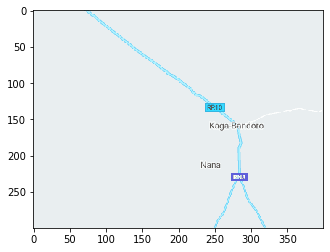

In [20]:
plt.imshow(x[0])

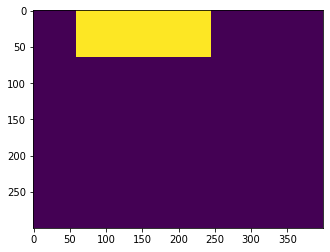

In [22]:
plt.imshow(y[0].reshape((300, 400)))

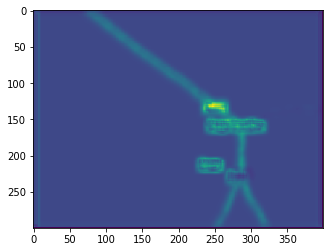

In [25]:
plt.imshow(autoencoder.predict(x[:1])[0].reshape((300, 400)))

Выделяет надписи... мда

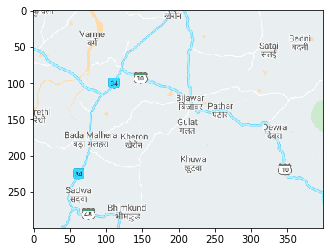

In [28]:
plt.imshow(x[2])

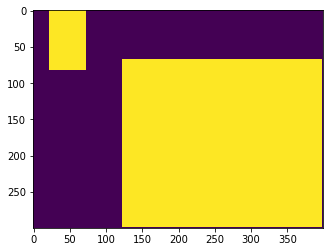

In [29]:
plt.imshow(y[2].reshape((300, 400)))

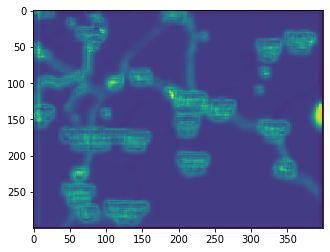

In [30]:
plt.imshow(autoencoder.predict(x[2:3])[0].reshape((300, 400)))

In [33]:
res = autoencoder.predict(x[2:3])[0].reshape((300, 400))
(res >= 0.5).sum()

0

In [40]:
res = autoencoder.predict(x[2:3])[0].reshape((300, 400))
(res >= 0.15).sum()

213

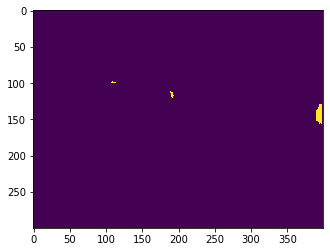

In [41]:
plt.imshow(res >= 0.15)

In [44]:
((res >= 0.15) * y[2].reshape((300, 400))).sum()

193.0

### Теперь нужно научиться считать accuracy и подобрать порог с наибольшим значением этой метрики

In [23]:
def accuracy_score_one(orig, pred, thresh):
    res = (pred >= thresh)
    
    return (res.reshape((300, 400)) * orig.reshape((300, 400))).sum() / (300 * 400)

In [54]:
accuracy_score_one(y[2], res, 0.15)

0.0016083333333333334

In [55]:
accuracy_score_one(y[2], res, 0.5)

0.0

In [56]:
accuracy_score_one(y[2], res, 0.1)

0.0143

In [57]:
accuracy_score_one(y[2], res, 0.05)

0.12895833333333334

In [24]:
def accuracy_score(orig_list, pred_list, thresh):
    accs = [accuracy_score_one(orig_list[i], pred_list[i], thresh) for i in range(len(orig_list))]
    
    return np.mean(accs)

In [59]:
pred = autoencoder.predict(x)
accuracy_score(y, pred, 0.15)

0.00016083333333333333

In [60]:
pred = autoencoder.predict(x)
accuracy_score(y, pred, 0.1)

0.00143

In [61]:
pred = autoencoder.predict(x)
accuracy_score(y, pred, 0.05)

0.013748333333333331

Заметно, что accuracy растёт с уменьшением treshold'a из за проблем с разметкой. 

Попробуем обучиться на картинках со спутника, возможно, это что-то даст.

Но будем держать в голове ещё такой вариант - чисто эмпирически посмотреть, какой результат кажется наилучшим (threshold'a) и его выбрать и использовать. (По одной картинке выглядит, как будто 0.15 довольно оптимален).

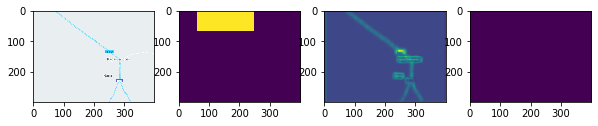

In [69]:
plt.figure(figsize=(10, 12))

plt.subplot(141)
plt.imshow(x[0])

plt.subplot(142)
plt.imshow(y[0].reshape((300, 400)))

plt.subplot(143)
plt.imshow(pred[0].reshape((300, 400)))

plt.subplot(144)
plt.imshow(pred[0].reshape((300, 400)) >= 0.15)

plt.show()

In [10]:
def show_all(i):
    plt.figure(figsize=(20, 25))

    plt.subplot(141)
    plt.imshow(x[i])

    plt.subplot(142)
    plt.imshow(y[i].reshape((300, 400)))

    plt.subplot(143)
    plt.imshow(pred[i].reshape((300, 400)))

    plt.subplot(144)
    plt.imshow(pred[i].reshape((300, 400)) >= 0.15)

    plt.show()

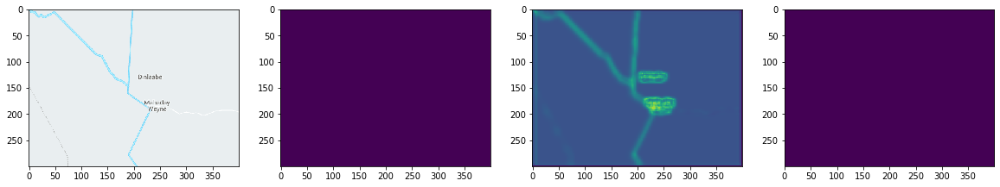

In [75]:
show_all(1)

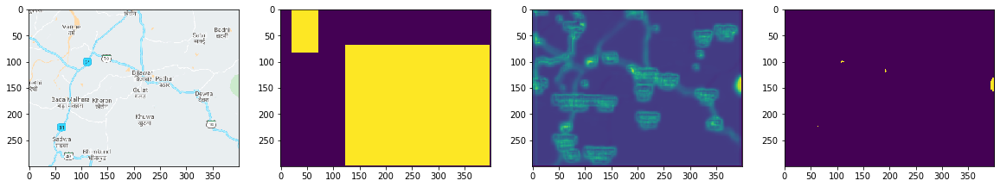

In [76]:
show_all(2)

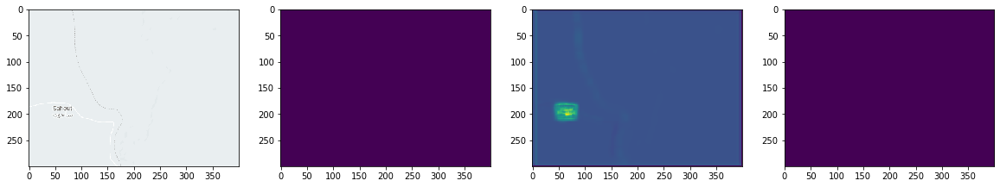

In [77]:
show_all(3)

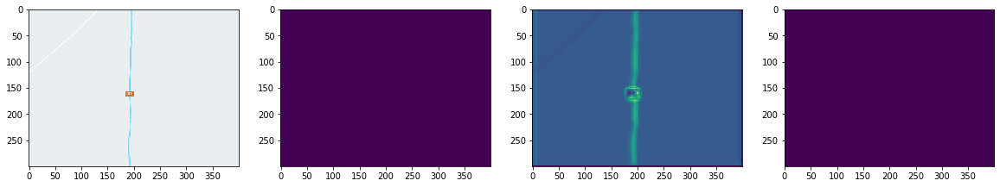

In [78]:
show_all(4)

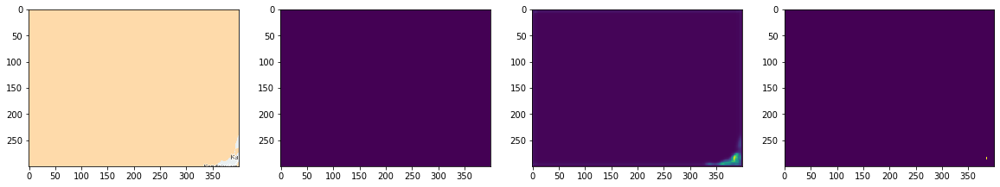

In [79]:
show_all(5)

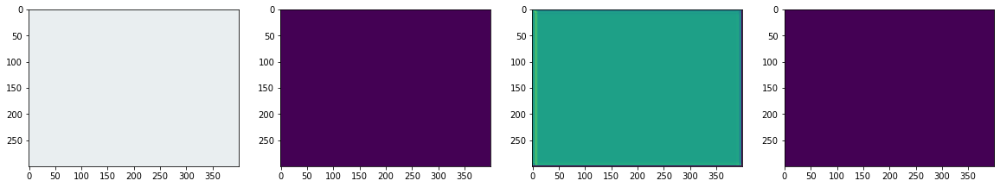

In [80]:
show_all(6)

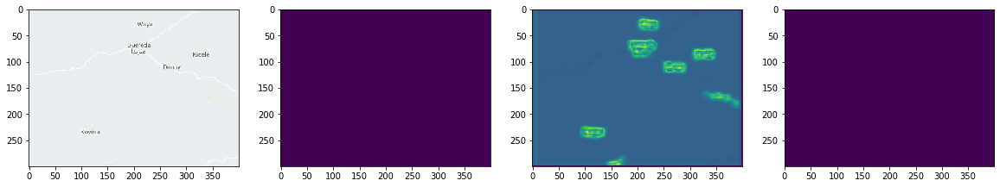

In [81]:
show_all(7)

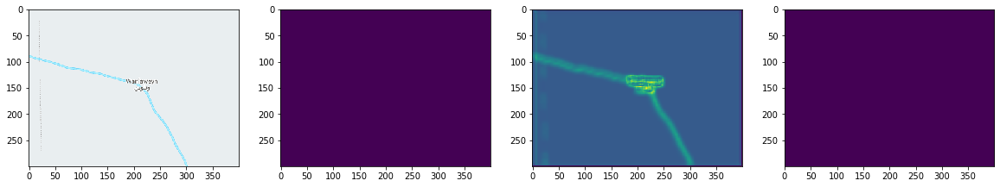

In [82]:
show_all(8)

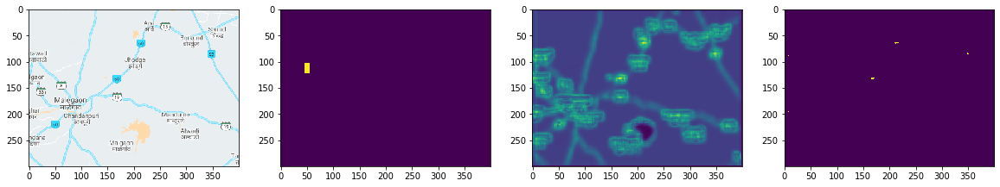

In [83]:
show_all(9)

In [85]:
x, y = training_generator_map_wood.__getitem__(1)

pred = autoencoder.predict(x)

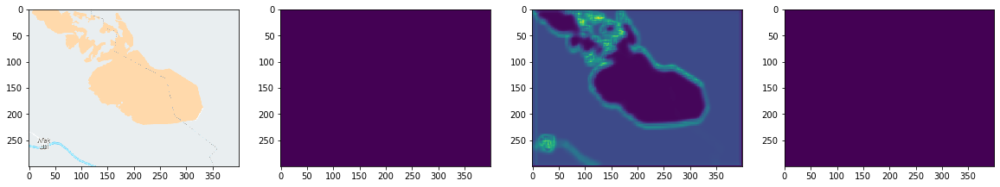

In [86]:
show_all(0)

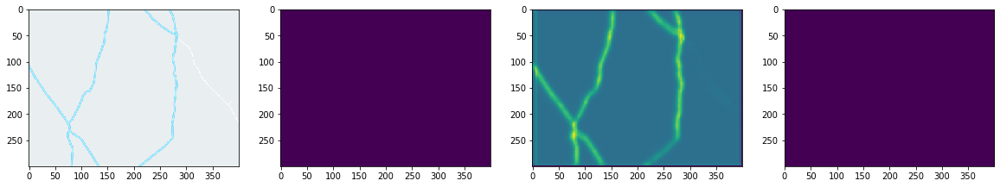

In [87]:
show_all(1)

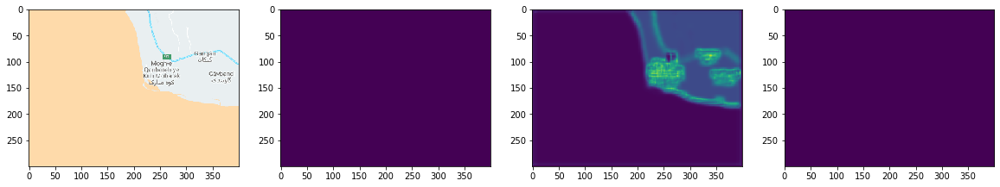

In [88]:
show_all(2)

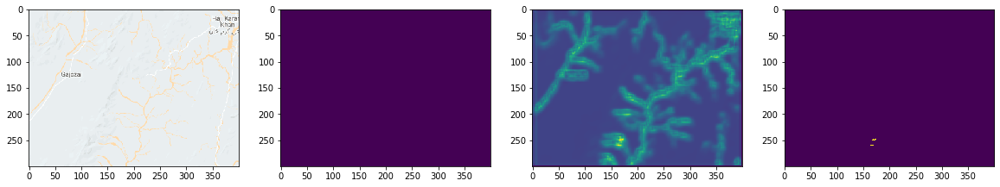

In [89]:
show_all(3)

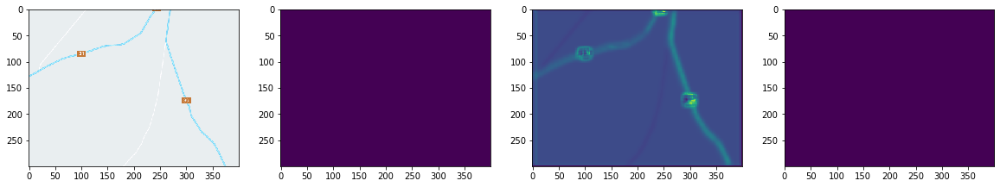

In [90]:
show_all(4)

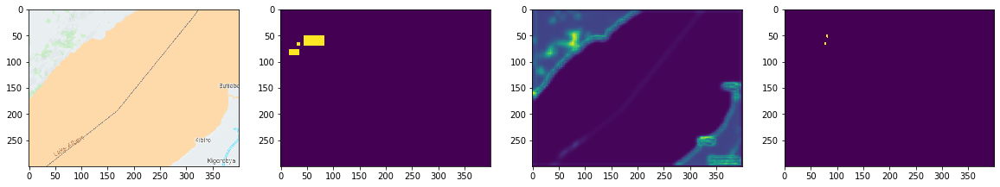

In [91]:
show_all(5)

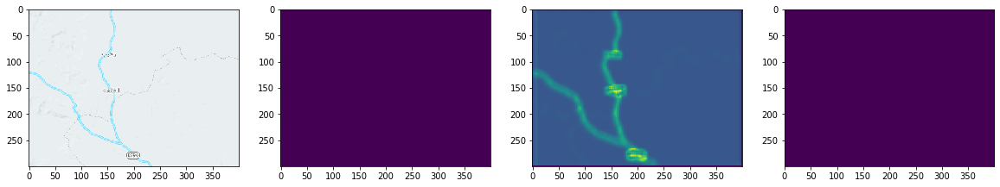

In [97]:
show_all(6)

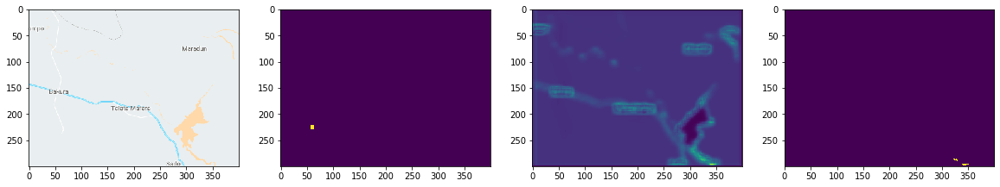

In [98]:
show_all(7)

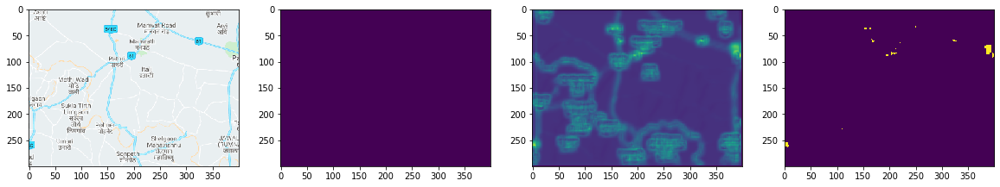

In [99]:
show_all(8)

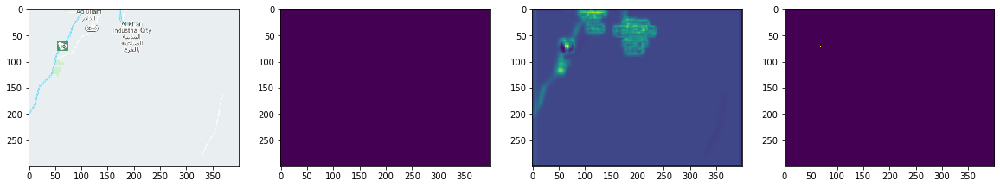

In [100]:
show_all(9)

In [101]:
x, y = training_generator_map_wood.__getitem__(2)

pred = autoencoder.predict(x)

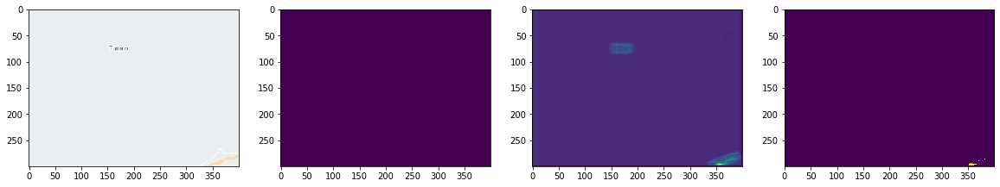

In [102]:
show_all(0)

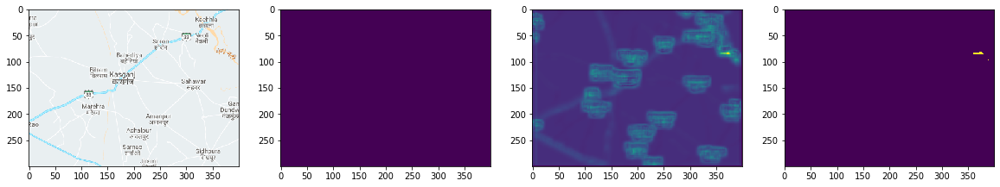

In [103]:
show_all(1)

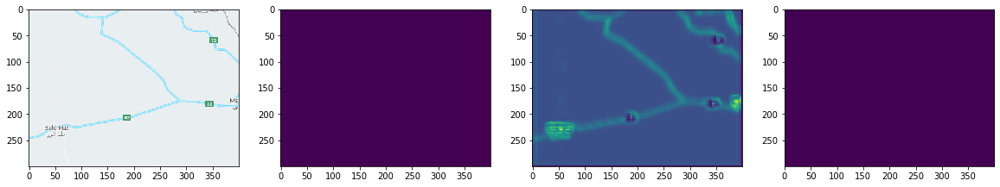

In [104]:
show_all(2)

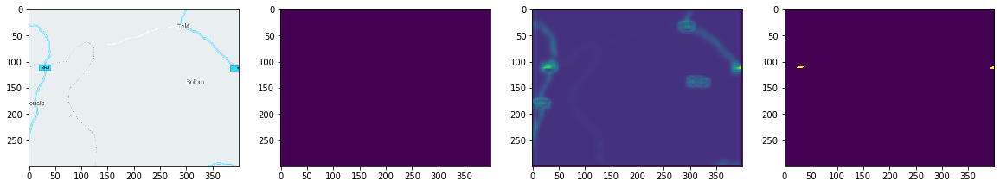

In [105]:
show_all(3)

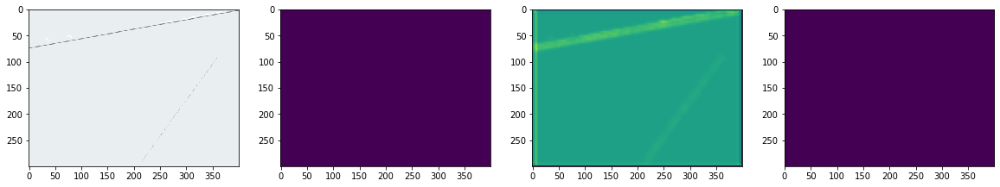

In [106]:
show_all(4)

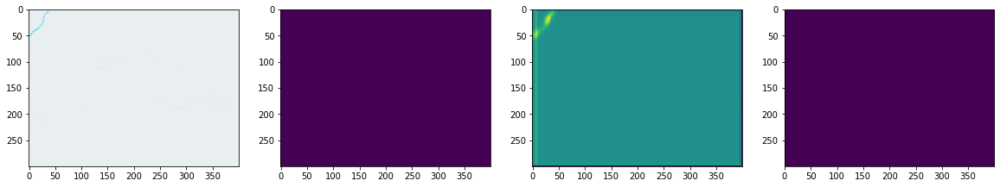

In [107]:
show_all(5)

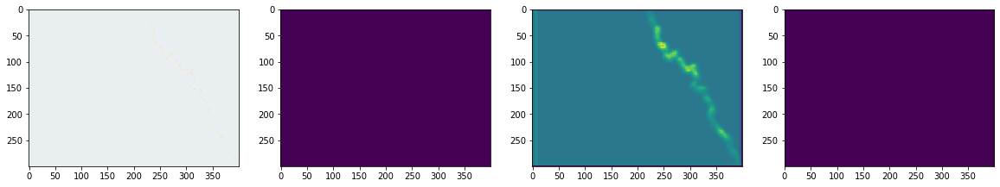

In [108]:
show_all(6)

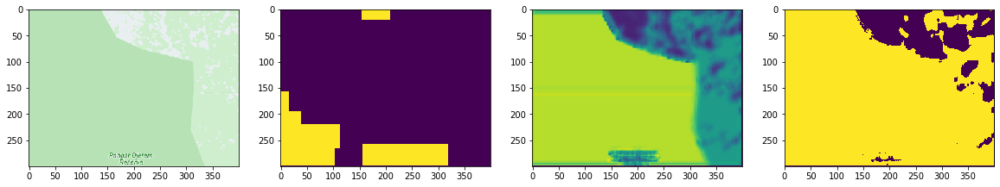

In [109]:
show_all(7)

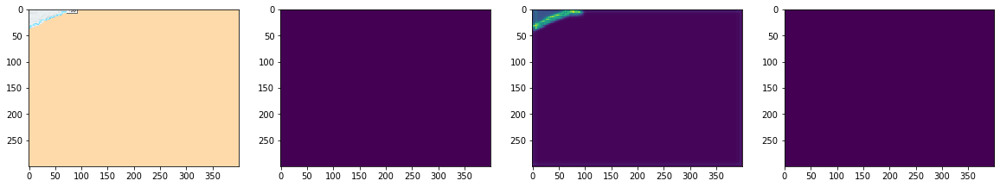

In [110]:
show_all(8)

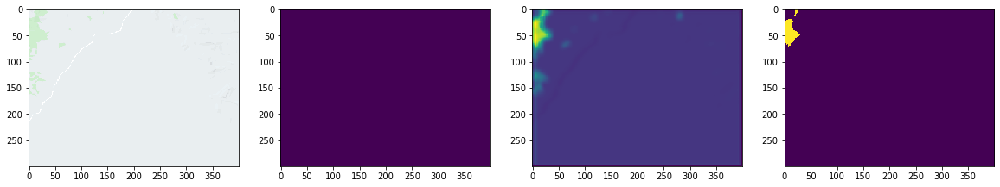

In [111]:
show_all(9)

### Попробуем сделать то же самое (обучить модельку) но для спутников. Посмотрим, что получится.

In [8]:
training_generator_satellite_wood = DataGenerator(
    train_filenames,
    X_path=satellites_folder,
    Y_path=masks_folder,
    classid=0,
    batch_size=5
)

validation_generator_satellite_wood = DataGenerator(
    validate_filenames,
    X_path=satellites_folder,
    Y_path=masks_folder,
    classid=0,
    batch_size=5
)

In [119]:
x, y = training_generator_map_wood.__getitem__(0)

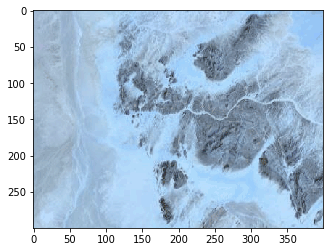

In [120]:
plt.imshow(x[0])

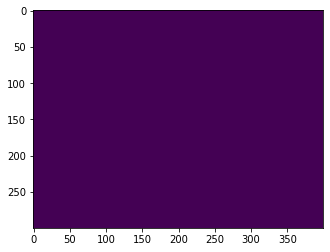

In [123]:
plt.imshow(y[0].reshape((300, 400)))

In [121]:
input_img = Input(shape=(300, 400, 3))

# Model Construction
x = Conv2D(32, (3, 3), activation='relu', padding='same')(input_img)
x = MaxPooling2D((2, 2), padding='same')(x)
x = Conv2D(32, (3, 3), activation='relu', padding='same')(x)
encoded = MaxPooling2D((2, 2), padding='same')(x)
# At this point the representation is (7, 7, 32)
x = Conv2D(32, (3, 3), activation='relu', padding='same')(encoded)
x = UpSampling2D((2, 2))(x)
x = Conv2D(32, (3, 3), activation='relu', padding='same')(x)
x = UpSampling2D((2, 2))(x)
decoded = Conv2D(1, (3, 3), activation='sigmoid', padding='same')(x)
autoencoder = Model(input_img, decoded)
autoencoder.compile(optimizer='adam', loss='binary_crossentropy')

In [127]:
early_stopping = EarlyStopping(monitor='val_loss', mode='min', verbose=1, patience=3)
model_checkpoint = ModelCheckpoint('AUTOENCODER_MODEL/best_model_wood_satellite.h5',
                                   monitor='val_loss', mode='min', save_best_only=True)

In [128]:
autoencoder.fit_generator(
    generator=training_generator_satellite_wood,
    validation_data=validation_generator_satellite_wood,
    use_multiprocessing=True,
    workers=6,
    epochs=200,
    callbacks=[early_stopping, model_checkpoint]
)

Epoch 1/200
1309/1310 [============================>.] - ETA: 0s - loss: 0.1532Epoch 1/200
Epoch 1/200
1310/1310 [==============================] - 1011s 771ms/step - loss: 0.1531 - val_loss: 0.1468
Epoch 2/200
1310/1310 [==============================] - 1043s 796ms/step - loss: 0.1456 - val_loss: 0.1421
Epoch 3/200
1310/1310 [==============================] - 1056s 806ms/step - loss: 0.1443 - val_loss: 0.1465
Epoch 4/200
1310/1310 [==============================] - 1052s 803ms/step - loss: 0.1419 - val_loss: 0.1407
Epoch 5/200
1310/1310 [==============================] - 1069s 816ms/step - loss: 0.1379 - val_loss: 0.1365
Epoch 6/200
  99/1310 [=>............................] - ETA: 15:15 - loss: 0.1400

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



In [129]:
x, y = training_generator_satellite_wood.__getitem__(1)

pred = autoencoder.predict(x)

In [9]:
def show_all(i):
    plt.figure(figsize=(20, 25))

    plt.subplot(141)
    plt.imshow(np.stack([x[i][:,:,2], x[i][:,:,1], x[i][:,:,0]], axis=2))

    plt.subplot(142)
    plt.imshow(y[i].reshape((300, 400)))

    plt.subplot(143)
    plt.imshow(pred[i].reshape((300, 400)))

    plt.subplot(144)
    plt.imshow(pred[i].reshape((300, 400)) >= 0.15)

    plt.show()

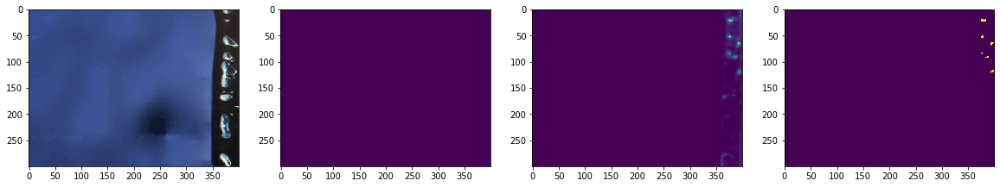

In [144]:
show_all(0)

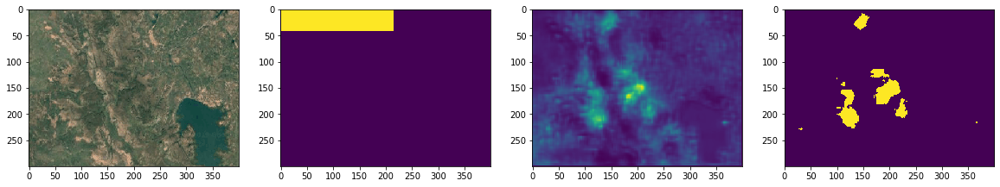

In [145]:
show_all(1)

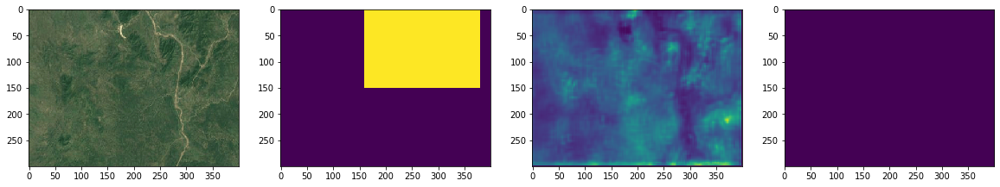

In [146]:
show_all(2)

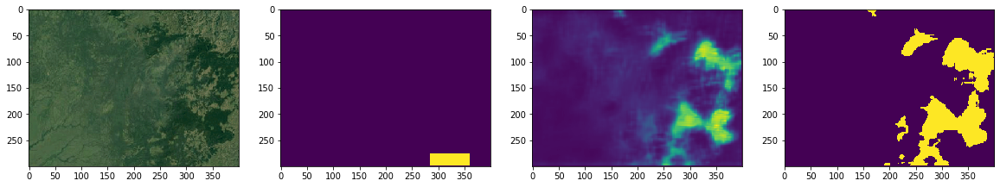

In [147]:
show_all(3)

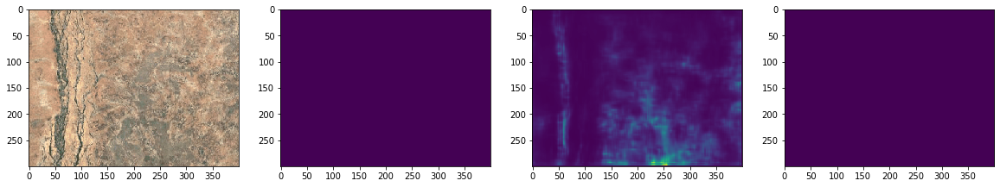

In [148]:
show_all(4)

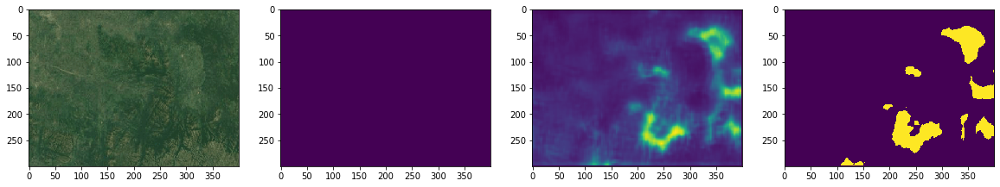

In [149]:
show_all(5)

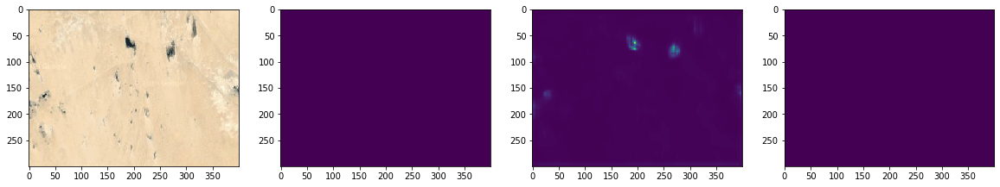

In [150]:
show_all(6)

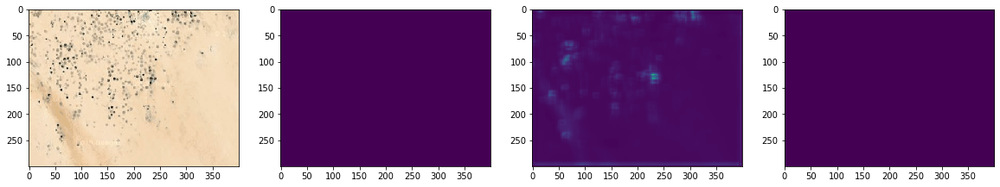

In [151]:
show_all(7)

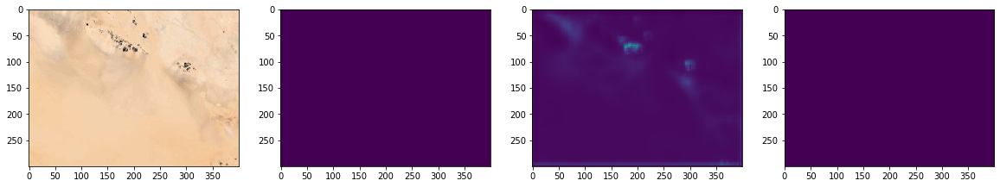

In [152]:
show_all(8)

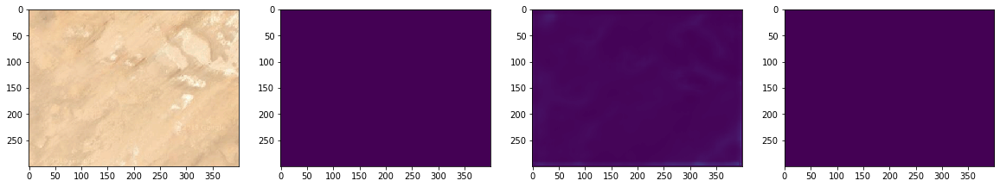

In [153]:
show_all(9)

In [154]:
x, y = training_generator_satellite_wood.__getitem__(0)

pred = autoencoder.predict(x)

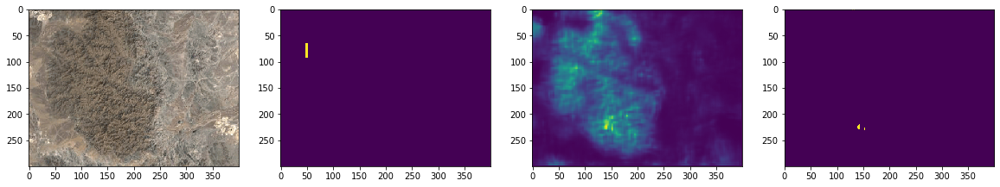

In [155]:
show_all(0)

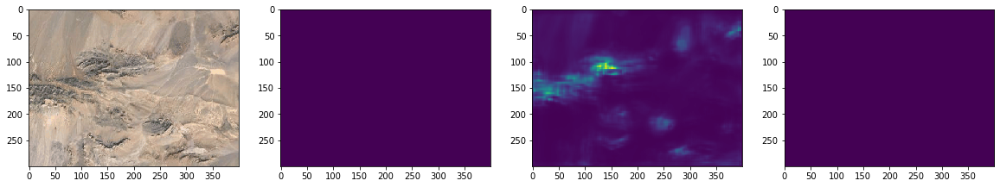

In [156]:
show_all(1)

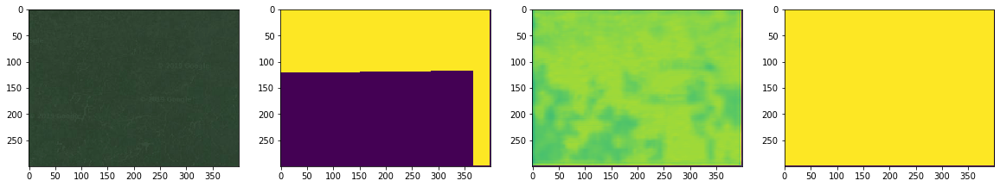

In [157]:
show_all(2)

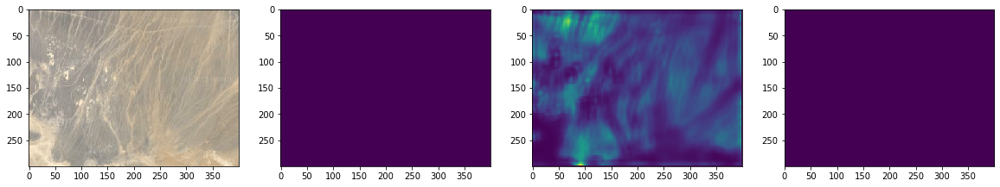

In [158]:
show_all(3)

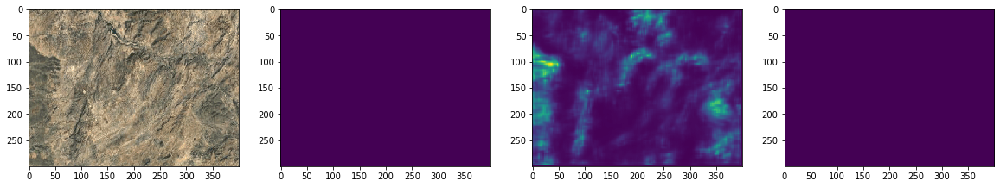

In [159]:
show_all(4)

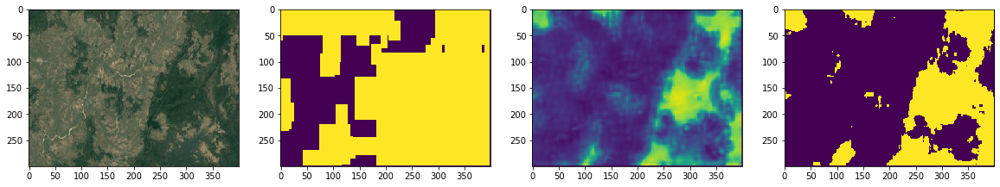

In [161]:
show_all(5)

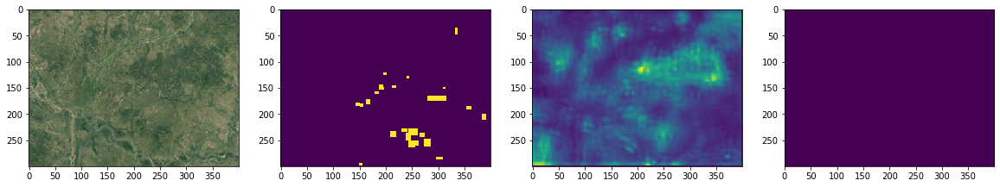

In [162]:
show_all(6)

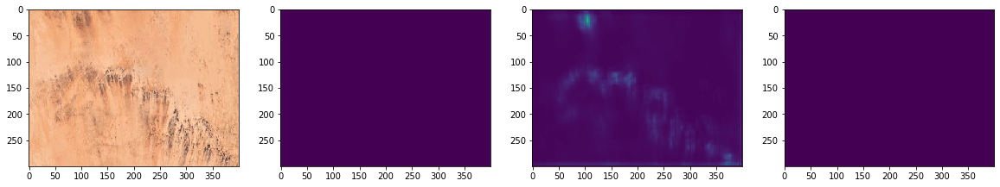

In [163]:
show_all(7)

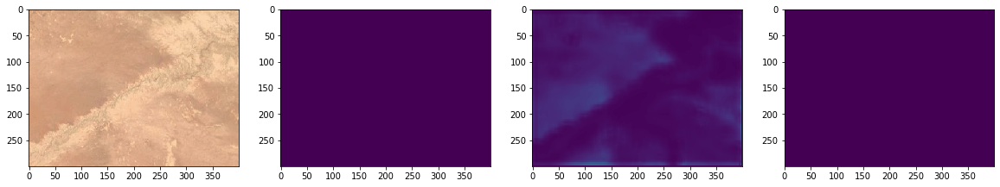

In [164]:
show_all(8)

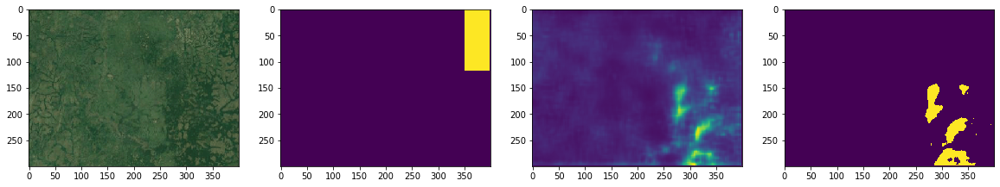

In [165]:
show_all(9)

#### validate

In [167]:
x, y = validation_generator_satellite_wood.__getitem__(0)

pred = autoencoder.predict(x)

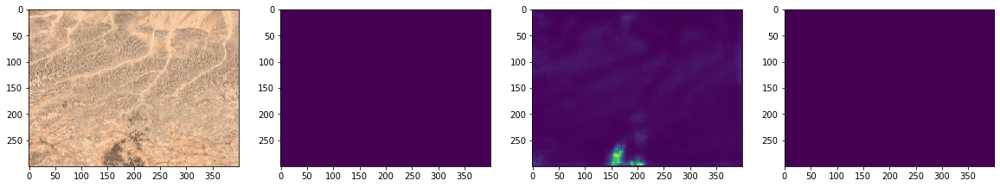

In [168]:
show_all(0)

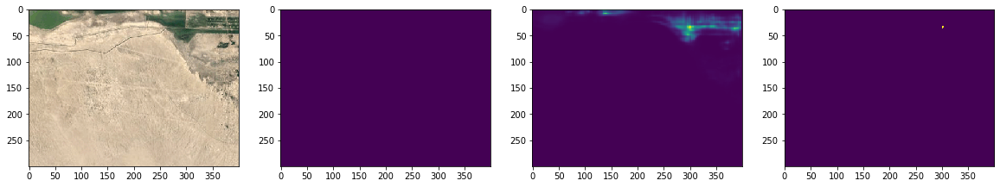

In [169]:
show_all(1)

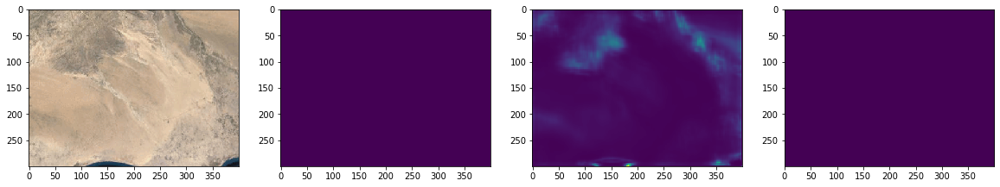

In [170]:
show_all(2)

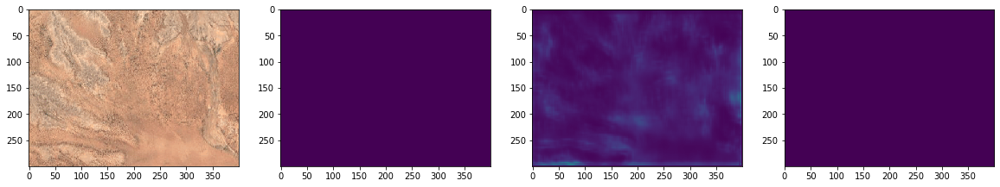

In [171]:
show_all(3)

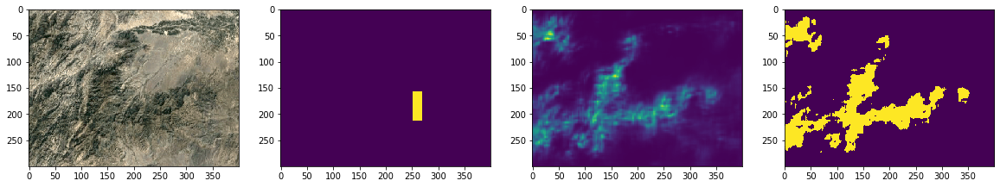

In [172]:
show_all(4)

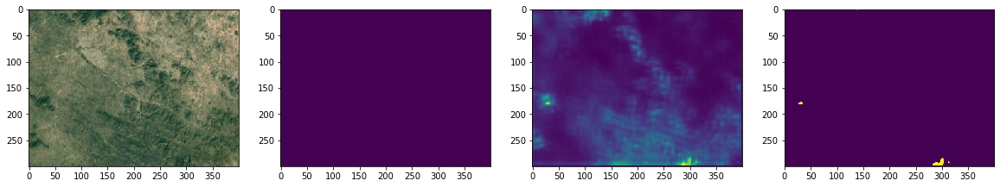

In [173]:
show_all(5)

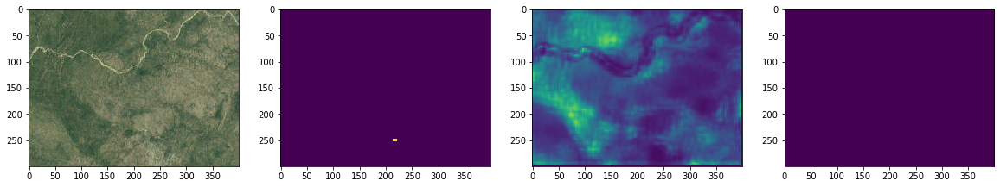

In [174]:
show_all(6)

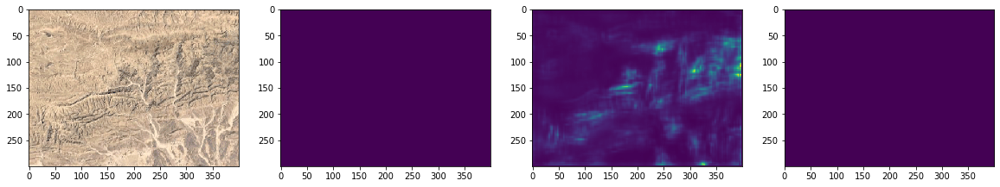

In [175]:
show_all(7)

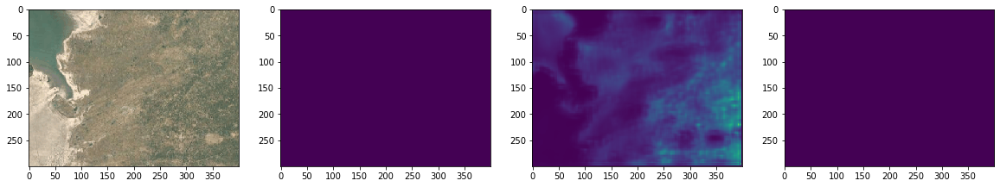

In [176]:
show_all(8)

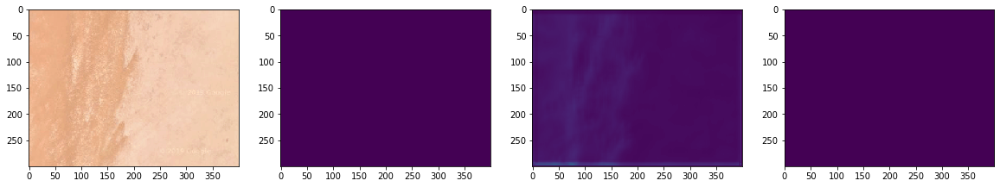

In [177]:
show_all(9)

In [178]:
x, y = validation_generator_satellite_wood.__getitem__(1)

pred = autoencoder.predict(x)

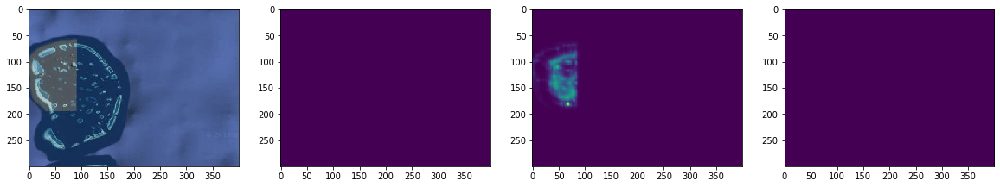

In [179]:
show_all(0)

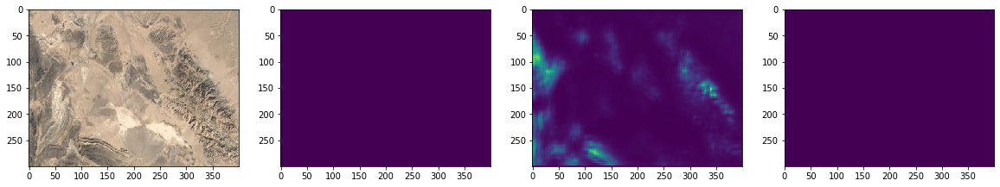

In [180]:
show_all(1)

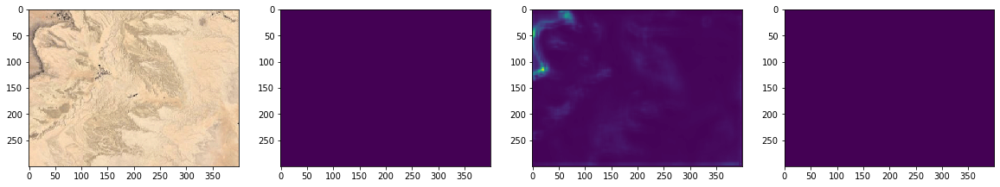

In [181]:
show_all(2)

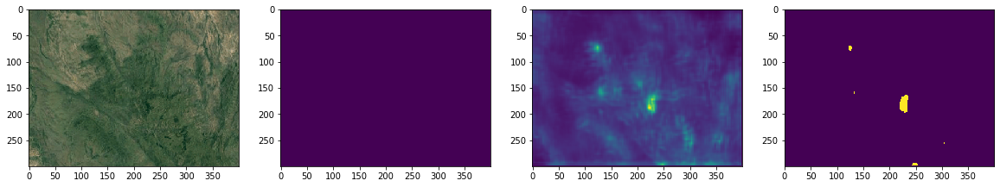

In [182]:
show_all(3)

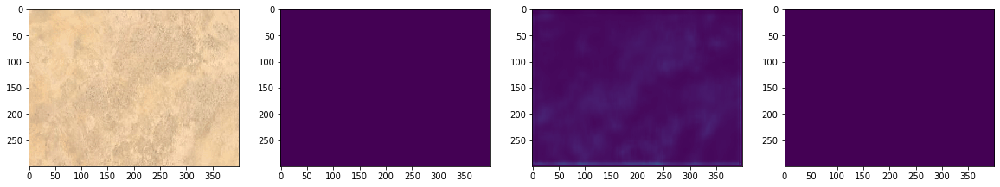

In [183]:
show_all(4)

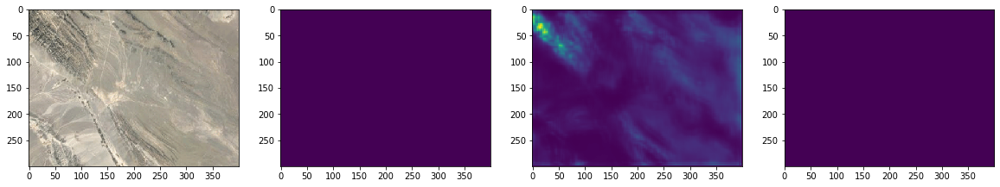

In [184]:
show_all(5)

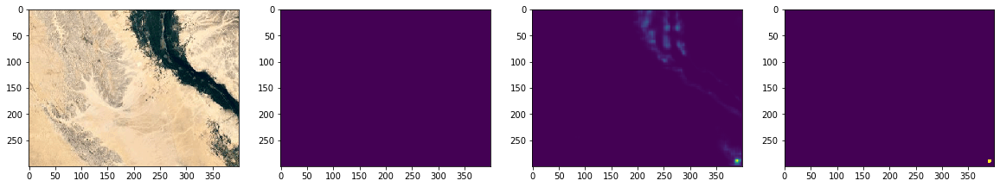

In [185]:
show_all(6)

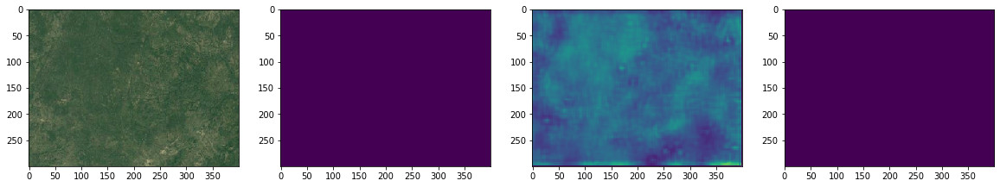

In [186]:
show_all(7)

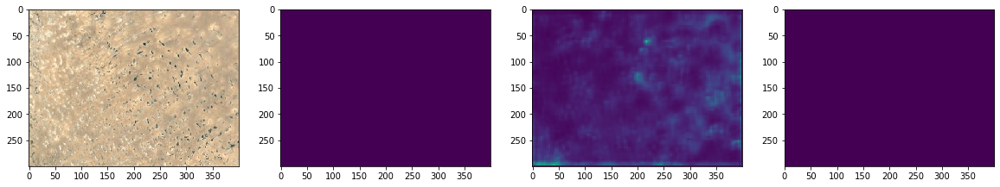

In [187]:
show_all(8)

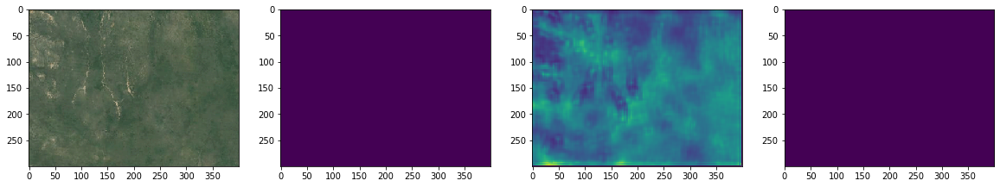

In [188]:
show_all(9)

In [189]:
accuracy_score(y, pred, 0.15)

0.0

In [190]:
accuracy_score(y, pred, 0.1)

0.0

In [191]:
accuracy_score(y, pred, 0.)

0.0

### Обучим модели на спутниках для других классов

In [ ]:
# {0: 'wood', 1: 'water', 2: 'valley', 3: 'peak', 4: 'ridge'}

In [65]:
## water

training_generator_satellite_water = DataGenerator(
    train_filenames,
    X_path=satellites_folder,
    Y_path=masks_folder,
    classid=1,
    batch_size=10
)

validation_generator_satellite_water = DataGenerator(
    validate_filenames,
    X_path=satellites_folder,
    Y_path=masks_folder,
    classid=1,
    batch_size=10
)


## valley

training_generator_satellite_valley = DataGenerator(
    train_filenames,
    X_path=satellites_folder,
    Y_path=masks_folder,
    classid=2,
    batch_size=10
)

validation_generator_satellite_valley = DataGenerator(
    validate_filenames,
    X_path=satellites_folder,
    Y_path=masks_folder,
    classid=2,
    batch_size=10
)


## peak

training_generator_satellite_peak = DataGenerator(
    train_filenames,
    X_path=satellites_folder,
    Y_path=masks_folder,
    classid=3,
    batch_size=10
)

validation_generator_satellite_peak = DataGenerator(
    validate_filenames,
    X_path=satellites_folder,
    Y_path=masks_folder,
    classid=3,
    batch_size=10
)


## ridge

training_generator_satellite_ridge = DataGenerator(
    train_filenames,
    X_path=satellites_folder,
    Y_path=masks_folder,
    classid=4,
    batch_size=10
)

validation_generator_satellite_ridge = DataGenerator(
    validate_filenames,
    X_path=satellites_folder,
    Y_path=masks_folder,
    classid=4,
    batch_size=10
)

In [10]:
def prepare_model():
    input_img = Input(shape=(300, 400, 3))

    # Model Construction
    x = Conv2D(32, (3, 3), activation='relu', padding='same')(input_img)
    x = MaxPooling2D((2, 2), padding='same')(x)
    x = Conv2D(32, (3, 3), activation='relu', padding='same')(x)
    encoded = MaxPooling2D((2, 2), padding='same')(x)
    # At this point the representation is (7, 7, 32)
    x = Conv2D(32, (3, 3), activation='relu', padding='same')(encoded)
    x = UpSampling2D((2, 2))(x)
    x = Conv2D(32, (3, 3), activation='relu', padding='same')(x)
    x = UpSampling2D((2, 2))(x)
    decoded = Conv2D(1, (3, 3), activation='sigmoid', padding='same')(x)
    autoencoder = Model(input_img, decoded)
    autoencoder.compile(optimizer='adam', loss='binary_crossentropy')
    
    return autoencoder


def train_model(autoencoder, model_filename, training_generator, validation_generator):
    early_stopping = EarlyStopping(monitor='val_loss', mode='min', verbose=1, patience=3)
    model_checkpoint = ModelCheckpoint(os.path.join('AUTOENCODER_MODEL/', model_filename),
                                   monitor='val_loss', mode='min', save_best_only=True)
    
    autoencoder.fit_generator(
        generator=training_generator,
        validation_data=validation_generator,
        use_multiprocessing=False,
        workers=6,
        epochs=200,
        callbacks=[early_stopping, model_checkpoint]
    )

In [15]:
# autoencoder = prepare_model()

# train_model(autoencoder, 'best_model_water_satellite.h5',
#             training_generator_satellite_water, validation_generator_satellite_water)








Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where



Epoch 1/200







Process ForkPoolWorker-8:
Process ForkPoolWorker-6:
Process ForkPoolWorker-12:
Process ForkPoolWorker-9:
Process ForkPoolWorker-10:
Traceback (most recent call last):
Traceback (most recent call last):
  File "/home/sima/anaconda3/envs/tf-gpu/lib/python3.7/multiprocessing/process.py", line 297, in _bootstrap
    self.run()
Process ForkPoolWorker-11:
Traceback (most recent call last):
Traceback (most recent call last):
  File "/home/sima/anaconda3/envs/tf-gpu/lib/python3.7/multiprocessing/process.py", line 99, in run
    self._target(*self._args, **self._kwargs)
Traceback (most recent call last):
  File "/home/sima/anaconda3/envs/tf-gpu/lib/python3.7/multiprocessing/process.py", line 297, in _bootstrap
    self.run()
  File "/home/sima/anaconda3/envs/tf-gpu/lib/python3.7/multiprocessing/process.py", line 297, in _bootstrap
    self.run()
  File "/home/sima/anaconda3/envs/tf-gpu/lib/python3.7/multiprocessing/pool.py", line 110, in worker
    task = get()
Process ForkPoolWorker-7:
  File 

KeyboardInterrupt
  File "/home/sima/anaconda3/envs/tf-gpu/lib/python3.7/multiprocessing/pool.py", line 110, in worker
    task = get()
KeyboardInterrupt
KeyboardInterrupt
  File "/home/sima/anaconda3/envs/tf-gpu/lib/python3.7/multiprocessing/queues.py", line 352, in get
    res = self._reader.recv_bytes()
KeyboardInterrupt
  File "/home/sima/anaconda3/envs/tf-gpu/lib/python3.7/multiprocessing/queues.py", line 351, in get
    with self._rlock:
KeyboardInterrupt
  File "/home/sima/anaconda3/envs/tf-gpu/lib/python3.7/multiprocessing/connection.py", line 216, in recv_bytes
    buf = self._recv_bytes(maxlength)
  File "/home/sima/anaconda3/envs/tf-gpu/lib/python3.7/multiprocessing/synchronize.py", line 95, in __enter__
    return self._semlock.__enter__()
KeyboardInterrupt
  File "/home/sima/anaconda3/envs/tf-gpu/lib/python3.7/multiprocessing/connection.py", line 407, in _recv_bytes
    buf = self._recv(4)
  File "/home/sima/anaconda3/envs/tf-gpu/lib/python3.7/multiprocessing/connection.py

KeyboardInterrupt: 

Process ForkPoolWorker-24:
Process ForkPoolWorker-18:
Process ForkPoolWorker-17:
Process ForkPoolWorker-13:
Traceback (most recent call last):
Process ForkPoolWorker-16:
Process ForkPoolWorker-21:
  File "/home/sima/anaconda3/envs/tf-gpu/lib/python3.7/multiprocessing/process.py", line 297, in _bootstrap
    self.run()
Traceback (most recent call last):
Process ForkPoolWorker-20:
  File "/home/sima/anaconda3/envs/tf-gpu/lib/python3.7/multiprocessing/process.py", line 99, in run
    self._target(*self._args, **self._kwargs)
Traceback (most recent call last):
Traceback (most recent call last):
Process ForkPoolWorker-15:
Process ForkPoolWorker-19:
Process ForkPoolWorker-22:
Process ForkPoolWorker-14:
  File "/home/sima/anaconda3/envs/tf-gpu/lib/python3.7/multiprocessing/process.py", line 297, in _bootstrap
    self.run()
  File "/home/sima/anaconda3/envs/tf-gpu/lib/python3.7/multiprocessing/pool.py", line 110, in worker
    task = get()
Traceback (most recent call last):
  File "/home/sima

In [16]:
# autoencoder = prepare_model()

# train_model(autoencoder, 'best_model_valley_satellite.h5',
#             training_generator_satellite_valley, validation_generator_satellite_valley)

Epoch 1/200
1310/1310 [==============================] - 1019s 778ms/step - loss: 0.0262 - val_loss: 0.0262
Epoch 2/200
1310/1310 [==============================] - 1020s 779ms/step - loss: 0.0241 - val_loss: 0.0263
Epoch 3/200
1310/1310 [==============================] - 1012s 773ms/step - loss: 0.0240 - val_loss: 0.0263
Epoch 4/200
1310/1310 [==============================] - 1027s 784ms/step - loss: 0.0240 - val_loss: 0.0263
Epoch 00004: early stopping


In [18]:
del autoencoder

In [14]:
autoencoder = prepare_model()

train_model(autoencoder, 'best_model_peak_satellite.h5',
            training_generator_satellite_peak, validation_generator_satellite_peak)








Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where



Epoch 1/200





1310/1310 [==============================] - 1021s 779ms/step - loss: 0.0412 - val_loss: 0.0376
Epoch 2/200
1310/1310 [==============================] - 1006s 768ms/step - loss: 0.0351 - val_loss: 0.0370
Epoch 3/200
1310/1310 [==============================] - 1018s 777ms/step - loss: 0.0347 - val_loss: 0.0375
Epoch 4/200
1310/1310 [==============================] - 1032s 788ms/step - loss: 0.0347 - val_loss: 0.0368
Epoch 5/200
1310/1310 [==============================] - 1028s 785ms/step - loss: 0.0345 - val_loss: 0.0368
Epoch 6/200
1310/1310 [==============================] - 1030s 786ms/step - loss: 0.0344 - val_loss: 0.0363
Epoch 7/200
1310/1310 [==============================] - 1033s 789ms/step - loss: 0.0345 - val_loss: 0.0362
Epoch 8/200
1310/1310 [==============================] - 1041s 794ms/step - loss: 0.0343 - val_loss: 0.0364
Epoch 9/200
1310/1310 [====

In [15]:
autoencoder = prepare_model()

train_model(autoencoder, 'best_model_ridge_satellite.h5',
            training_generator_satellite_ridge, validation_generator_satellite_ridge)

Epoch 1/200
1310/1310 [==============================] - 1040s 794ms/step - loss: 0.0386 - val_loss: 0.0349
Epoch 2/200
1310/1310 [==============================] - 1042s 796ms/step - loss: 0.0348 - val_loss: 0.0349
Epoch 3/200
1310/1310 [==============================] - 1031s 787ms/step - loss: 0.0350 - val_loss: 0.0349
Epoch 4/200
1310/1310 [==============================] - 1030s 786ms/step - loss: 0.0349 - val_loss: 0.0349
Epoch 5/200
1310/1310 [==============================] - 1033s 788ms/step - loss: 0.0348 - val_loss: 0.0349
Epoch 00005: early stopping


In [ ]:
print(5)

In [ ]:
del autoencoder

In [11]:
autoencoder = prepare_model()

train_model(autoencoder, 'best_model_wood_satellite.h5',
            training_generator_satellite_wood, validation_generator_satellite_wood)








Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where



Epoch 1/200





2621/2621 [==============================] - 1022s 390ms/step - loss: 0.1525 - val_loss: 0.1446
Epoch 2/200
2621/2621 [==============================] - 1031s 393ms/step - loss: 0.1463 - val_loss: 0.1460
Epoch 3/200
2621/2621 [==============================] - 1025s 391ms/step - loss: 0.1446 - val_loss: 0.1417
Epoch 4/200
2621/2621 [==============================] - 1028s 392ms/step - loss: 0.1420 - val_loss: 0.1404
Epoch 5/200
2621/2621 [==============================] - 1035s 395ms/step - loss: 0.1405 - val_loss: 0.1404
Epoch 6/200
2621/2621 [==============================] - 1026s 392ms/step - loss: 0.1389 - val_loss: 0.1408
Epoch 7/200
2621/2621 [==============================] - 1028s 392ms/step - loss: 0.1375 - val_loss: 0.1511
Epoch 00007: early stopping


In [21]:
# !chmod -R go+rw AUTOENCODER_MODEL/
# !ls -la AUTOENCODER_MODEL/

итого 2040
drwxrwxrwx  3 sima sima   4096 фев 21 11:16 .
drwxrwxrwx 11 sima sima  90112 фев 21 11:16 ..
-rw-rw-rw-  1 sima sima 394400 фев 19 22:41 best_model_peak_satellite.h5
-rw-rw-rw-  1 sima sima 394464 фев 20 00:08 best_model_ridge_satellite.h5
-rw-rw-rw-  1 sima sima 394464 фев 19 00:40 best_model_valley_satellite.h5
-rw-rw-rw-  1 sima sima 394472 фев 18 00:12 best_model_water_satellite.h5
-rw-rw-rw-  1 sima sima 394400 фев 16 17:24 best_model_wood.h5
drwxrwxrwx  2 sima sima   4096 фев 21 09:31 .ipynb_checkpoints


### Теперь нужно проверить, что все модельки (включая wood) загружаются и предсказание работает

In [12]:
from keras.models import load_model

In [201]:
autoencoder = load_model(os.path.join('AUTOENCODER_MODEL/', 'best_model_water_satellite.h5'))

In [202]:
x, y = validation_generator_satellite_water.__getitem__(1)

pred = autoencoder.predict(x)

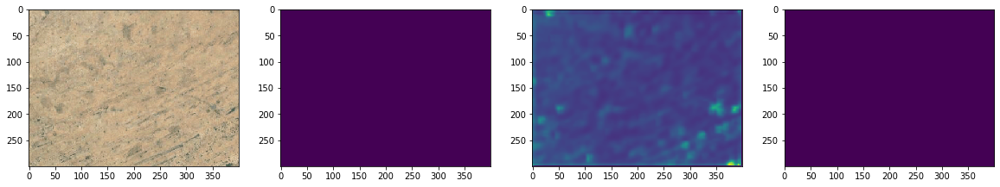

In [203]:
show_all(0)

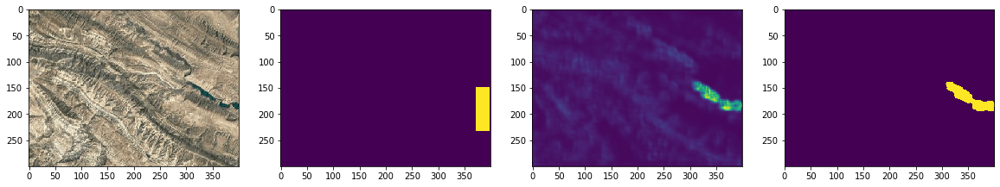

In [204]:
show_all(1)

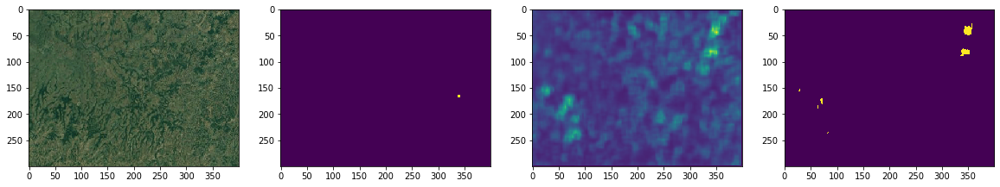

In [205]:
show_all(2)

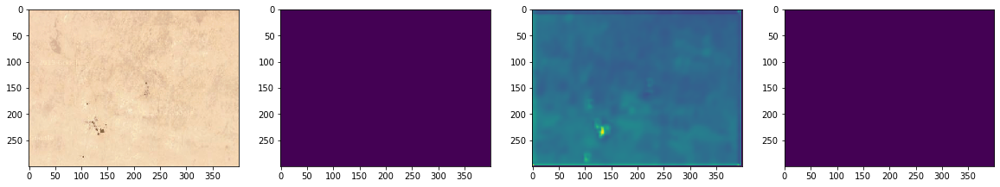

In [206]:
show_all(3)

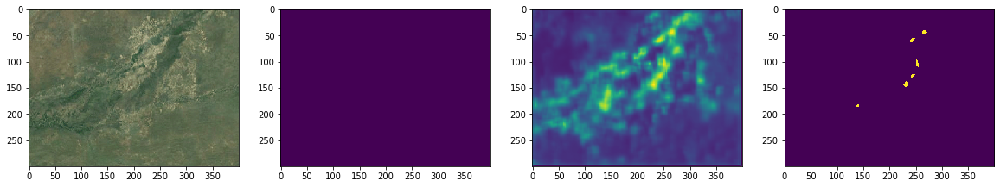

In [207]:
show_all(4)

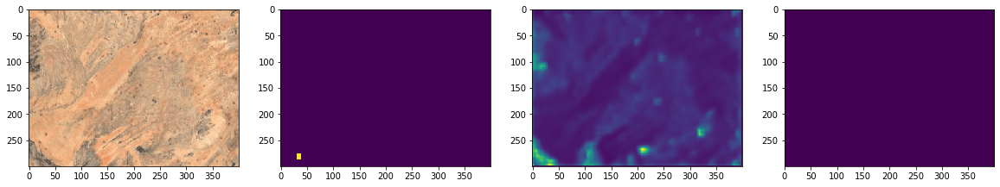

In [208]:
show_all(5)

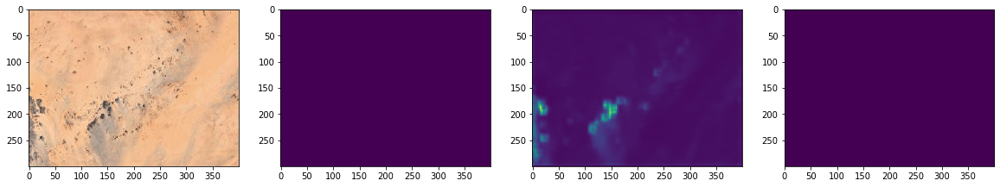

In [209]:
show_all(6)

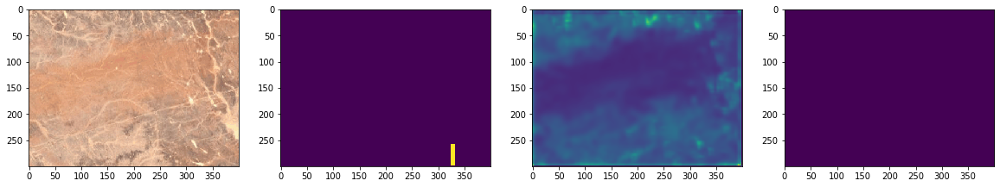

In [210]:
show_all(7)

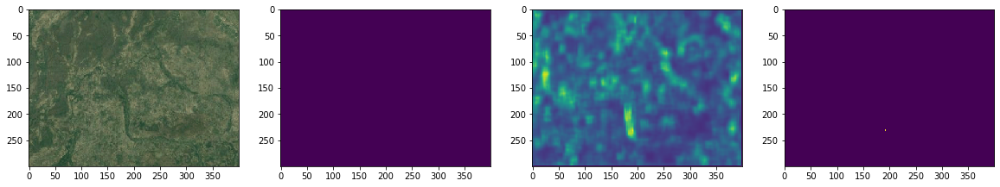

In [211]:
show_all(8)

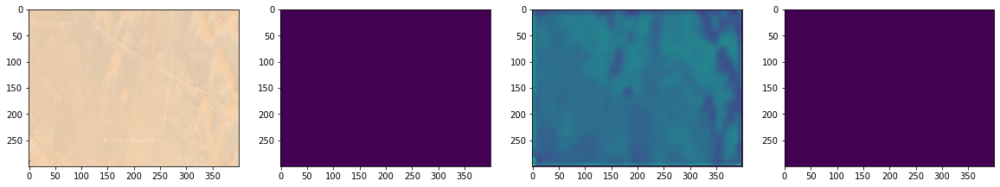

In [212]:
show_all(9)

In [213]:
x, y = validation_generator_satellite_water.__getitem__(0)

pred = autoencoder.predict(x)

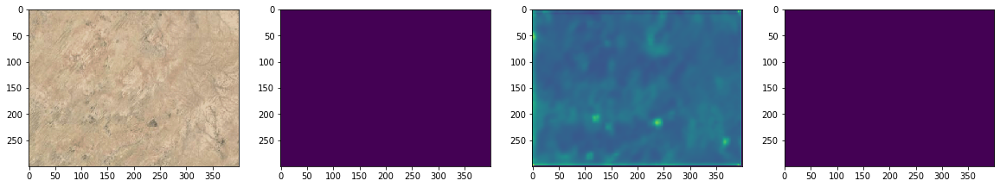

In [214]:
show_all(0)

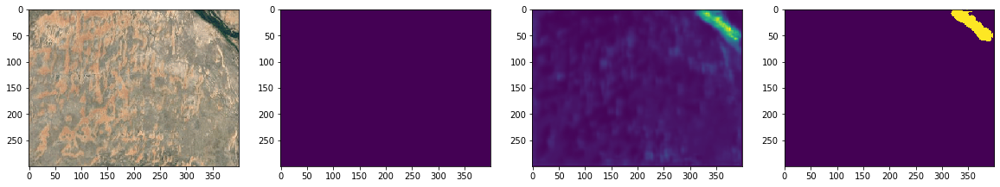

In [215]:
show_all(1)

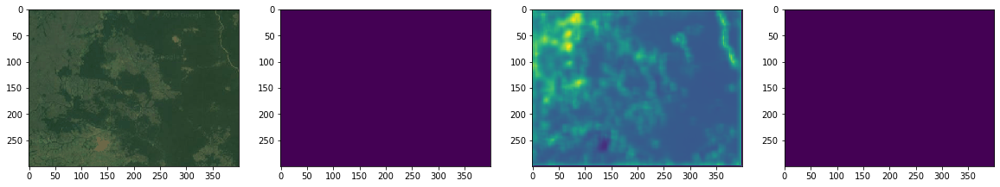

In [216]:
show_all(2)

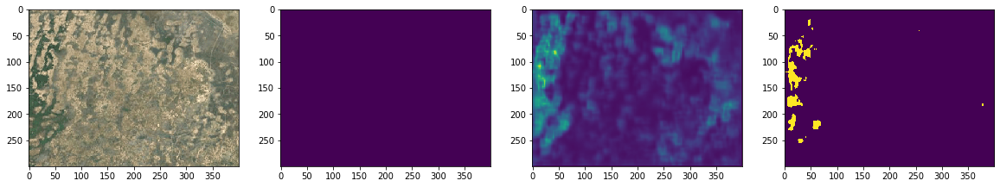

In [217]:
show_all(3)

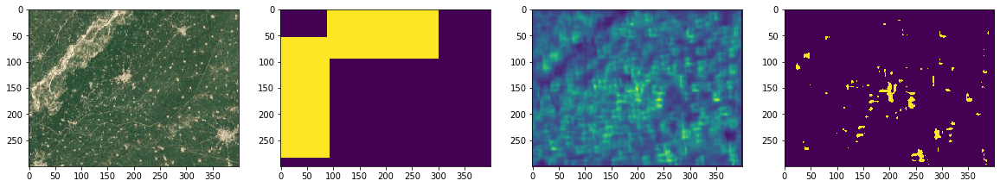

In [218]:
show_all(4)

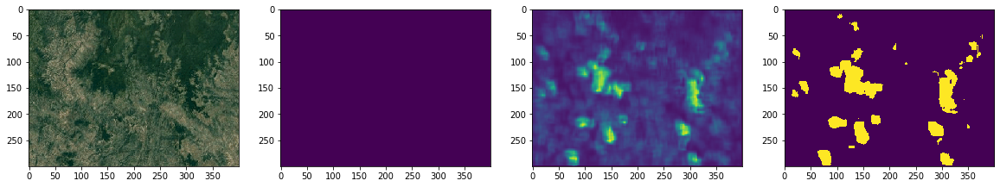

In [219]:
show_all(5)

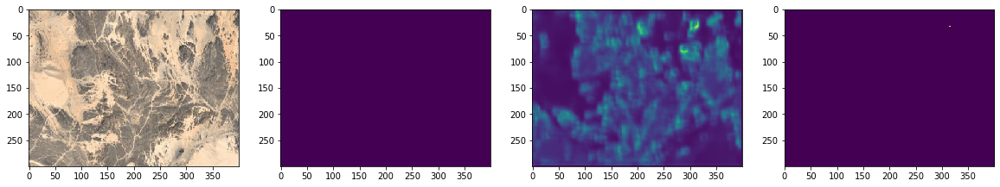

In [220]:
show_all(6)

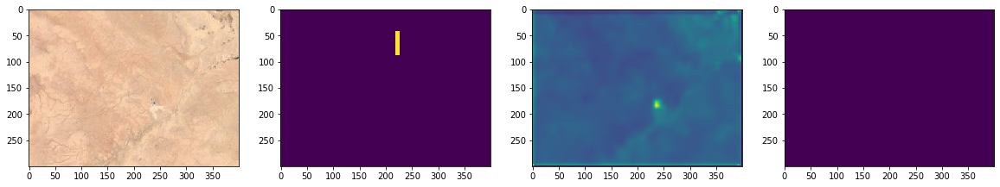

In [221]:
show_all(7)

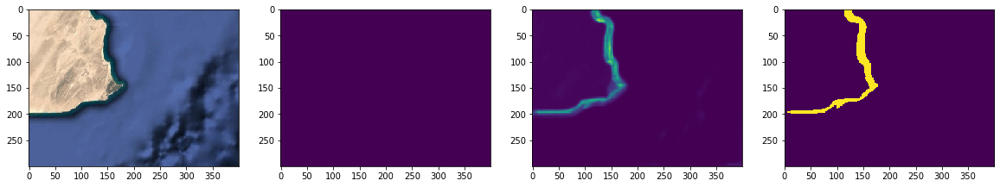

In [222]:
show_all(8)

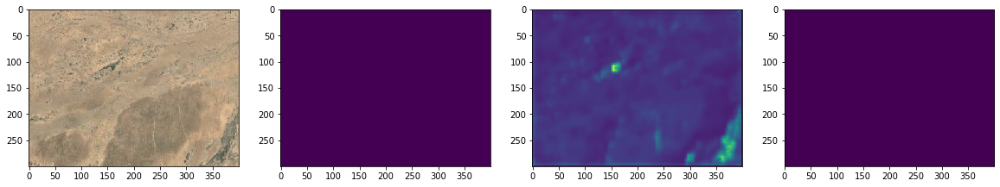

In [223]:
show_all(9)

In [224]:
x, y = validation_generator_satellite_water.__getitem__(2)

pred = autoencoder.predict(x)

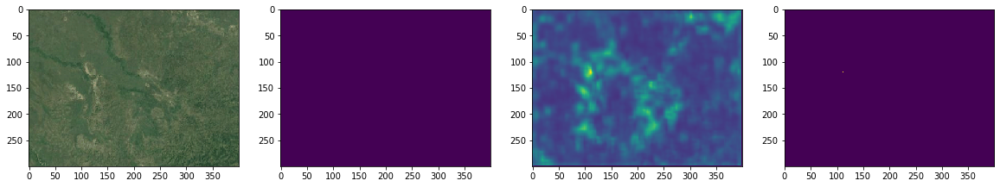

In [225]:
show_all(0)

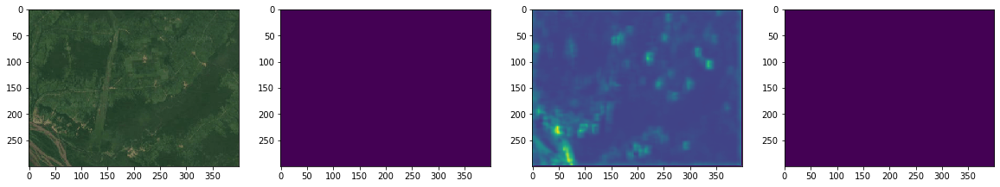

In [226]:
show_all(1)

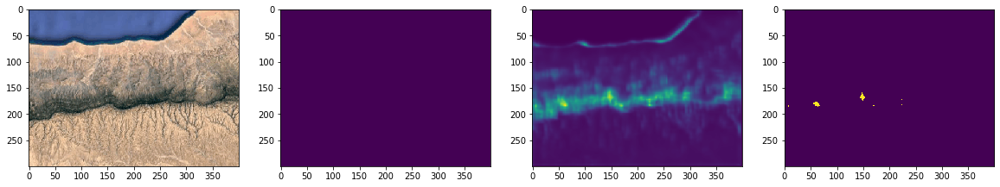

In [227]:
show_all(2)

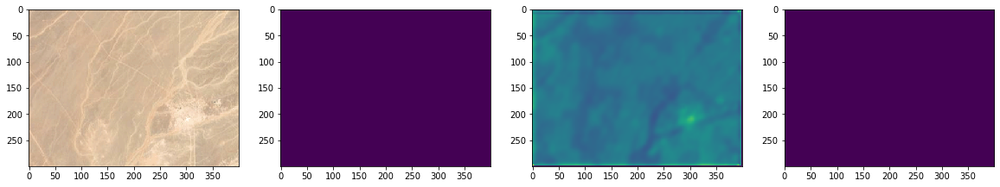

In [228]:
show_all(3)

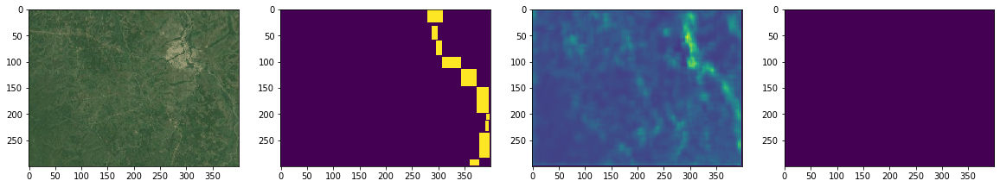

In [229]:
show_all(4)

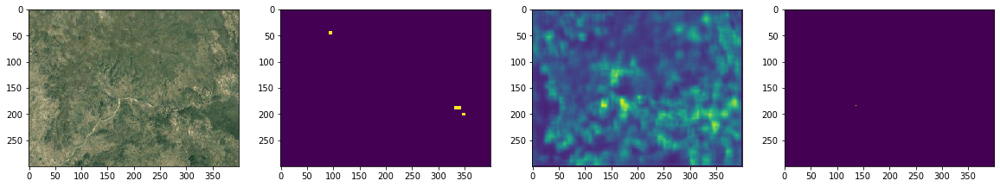

In [230]:
show_all(5)

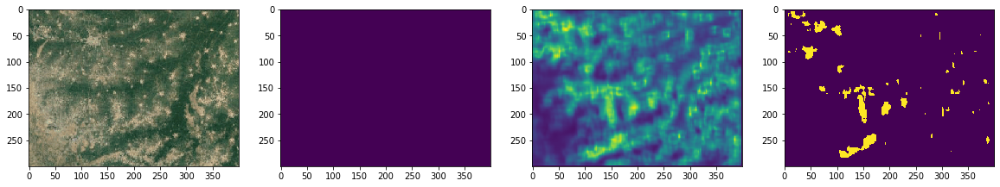

In [231]:
show_all(6)

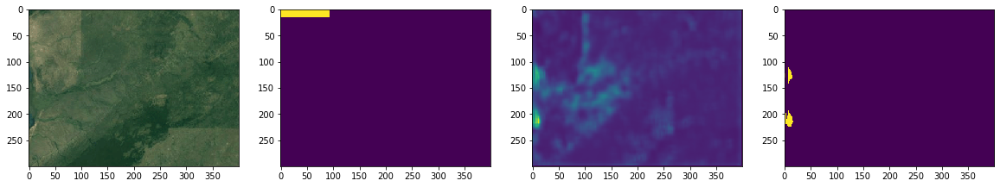

In [232]:
show_all(7)

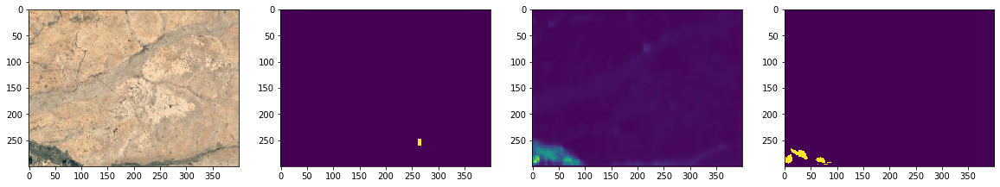

In [233]:
show_all(8)

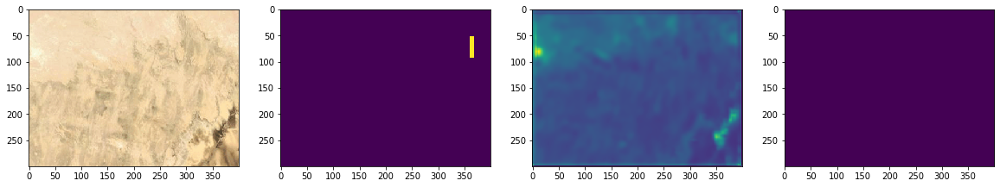

In [234]:
show_all(9)

In [13]:
autoencoder = load_model(os.path.join('AUTOENCODER_MODEL/', 'best_model_wood_satellite.h5'))

In [15]:
x, y = validation_generator_satellite_wood.__getitem__(1)

pred = autoencoder.predict(x)

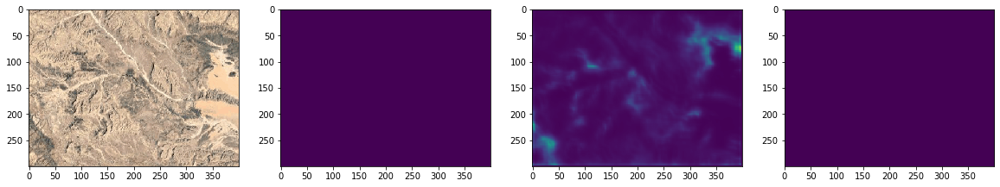

In [16]:
show_all(0)

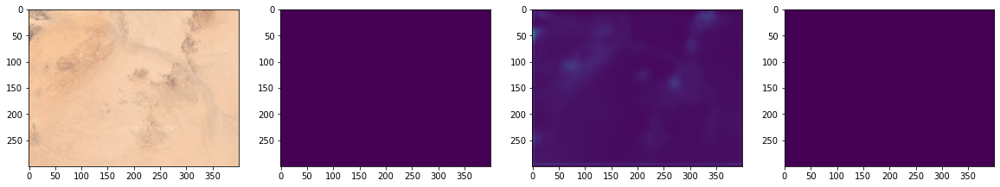

In [17]:
show_all(1)

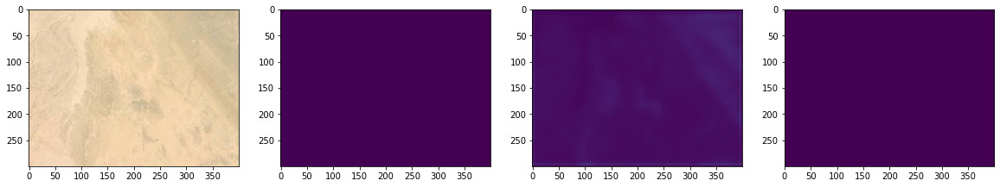

In [18]:
show_all(2)

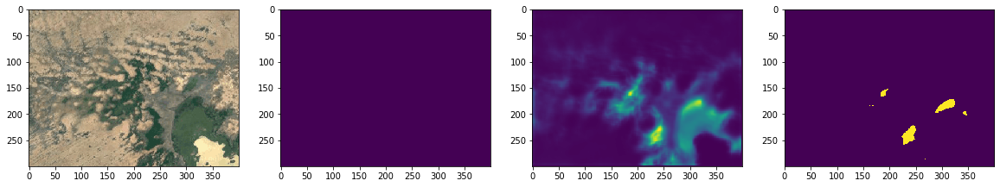

In [19]:
show_all(3)

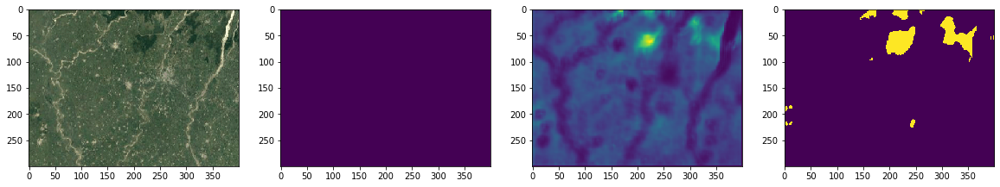

In [20]:
show_all(4)

In [23]:
x, y = validation_generator_satellite_wood.__getitem__(0)

pred = autoencoder.predict(x)

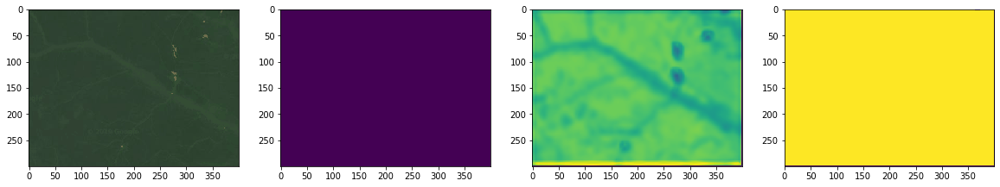

In [24]:
show_all(0)

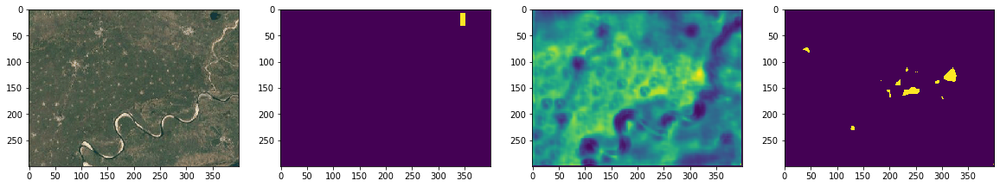

In [25]:
show_all(1)

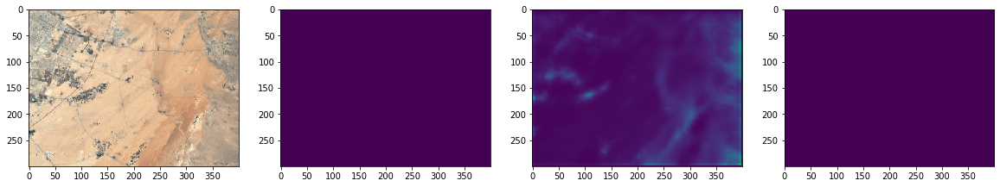

In [26]:
show_all(2)

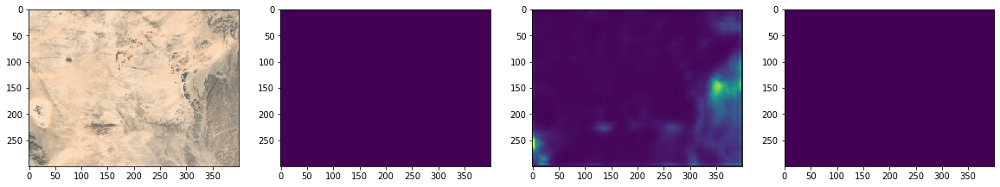

In [27]:
show_all(3)

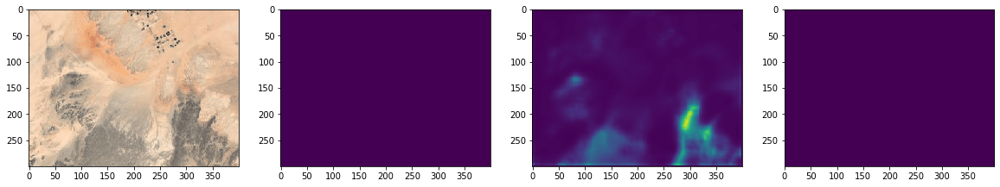

In [28]:
show_all(4)

In [29]:
x, y = validation_generator_satellite_wood.__getitem__(2)

pred = autoencoder.predict(x)

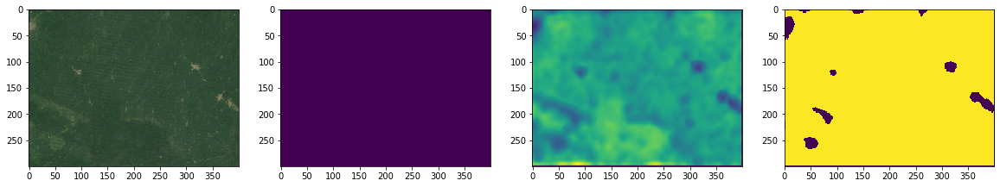

In [30]:
show_all(0)

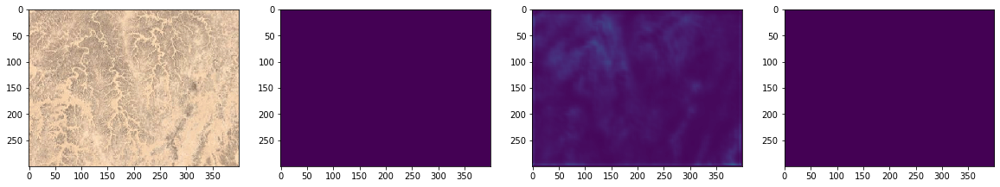

In [31]:
show_all(1)

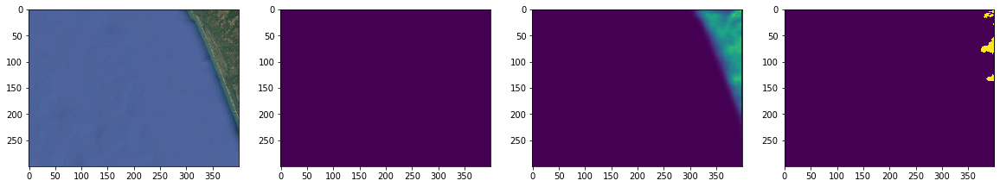

In [32]:
show_all(2)

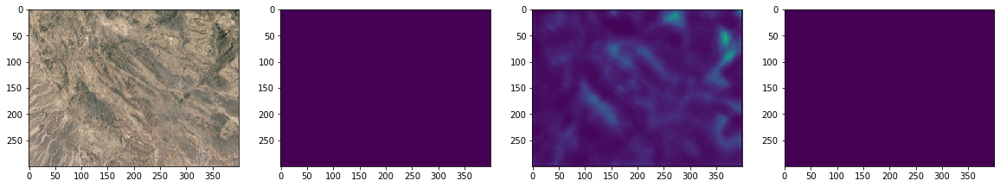

In [33]:
show_all(3)

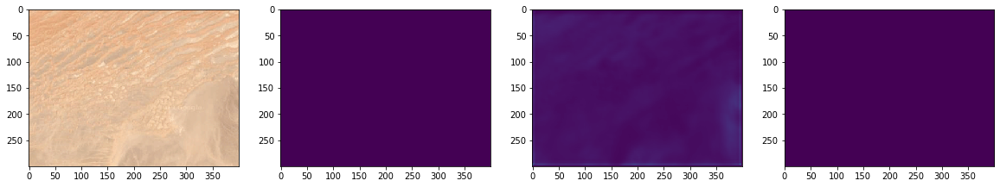

In [34]:
show_all(4)

In [35]:
x, y = validation_generator_satellite_wood.__getitem__(3)

pred = autoencoder.predict(x)

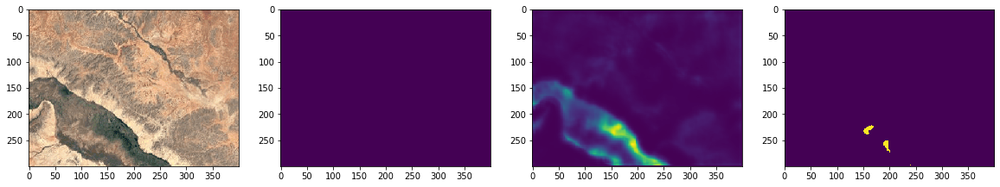

In [36]:
show_all(0)

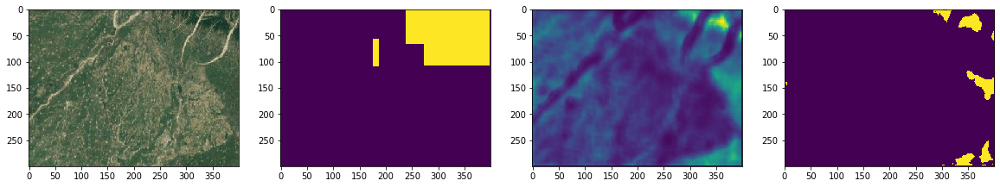

In [37]:
show_all(1)

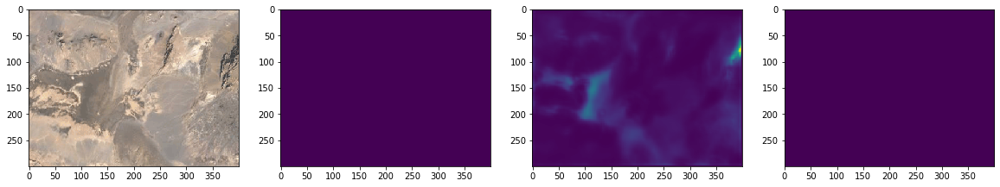

In [38]:
show_all(2)

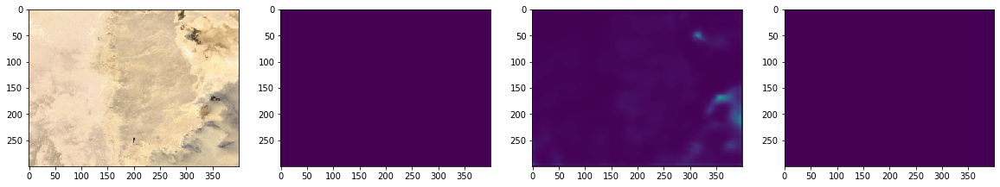

In [39]:
show_all(3)

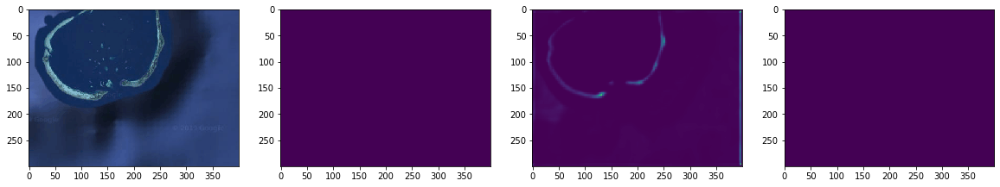

In [40]:
show_all(4)

In [41]:
x, y = validation_generator_satellite_wood.__getitem__(4)

pred = autoencoder.predict(x)

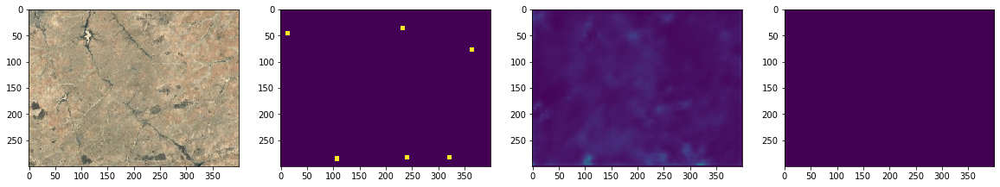

In [42]:
show_all(0)

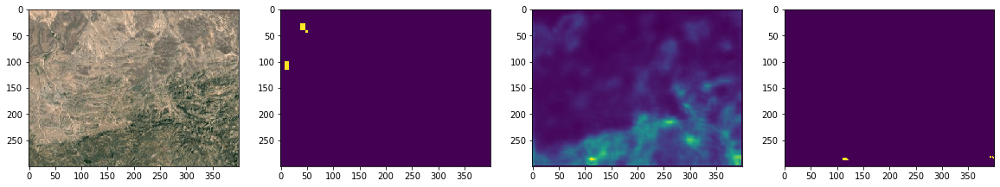

In [43]:
show_all(1)

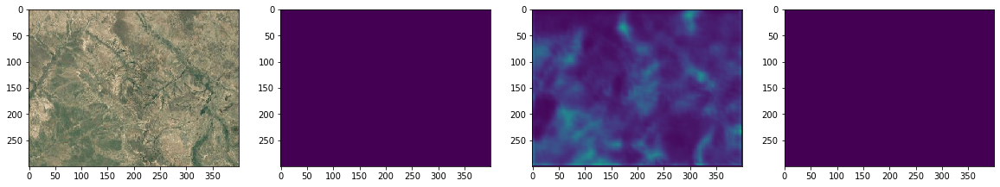

In [44]:
show_all(2)

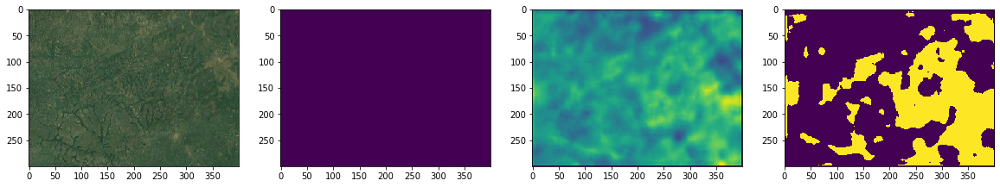

In [45]:
show_all(3)

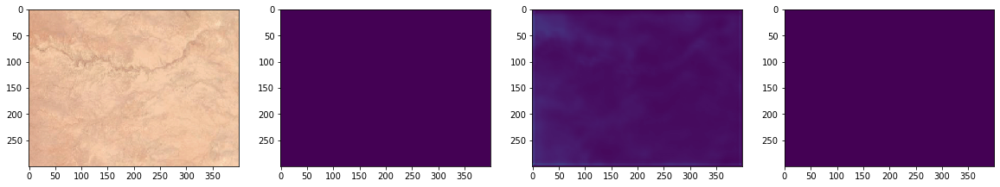

In [46]:
show_all(4)

In [47]:
x, y = validation_generator_satellite_wood.__getitem__(5)

pred = autoencoder.predict(x)

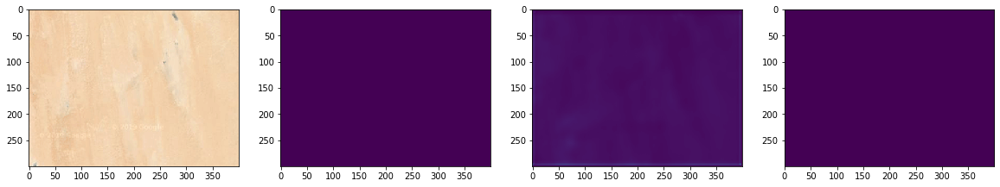

In [48]:
show_all(0)

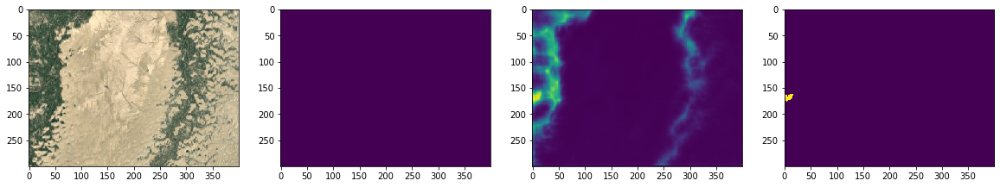

In [49]:
show_all(1)

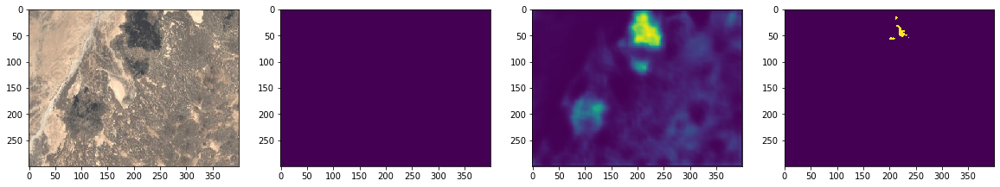

In [50]:
show_all(2)

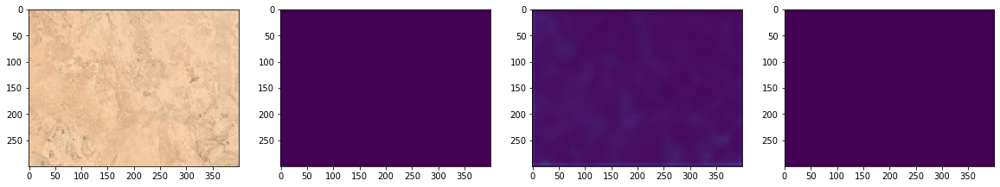

In [51]:
show_all(3)

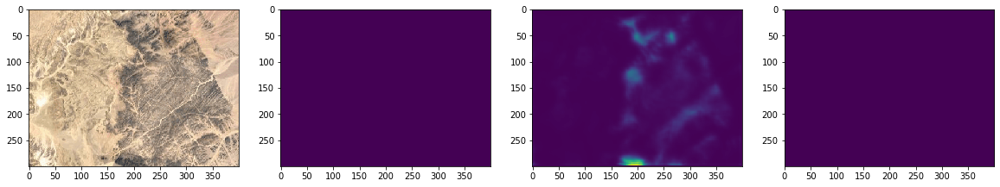

In [52]:
show_all(4)

In [53]:
x, y = validation_generator_satellite_wood.__getitem__(6)

pred = autoencoder.predict(x)

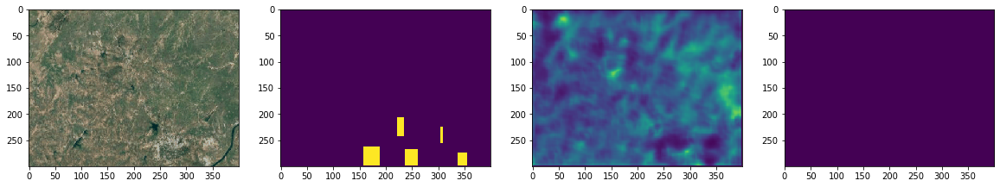

In [54]:
show_all(0)

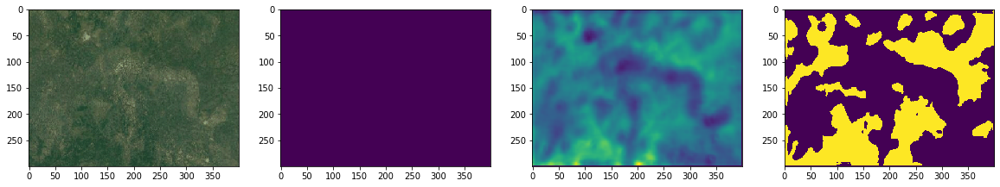

In [55]:
show_all(1)

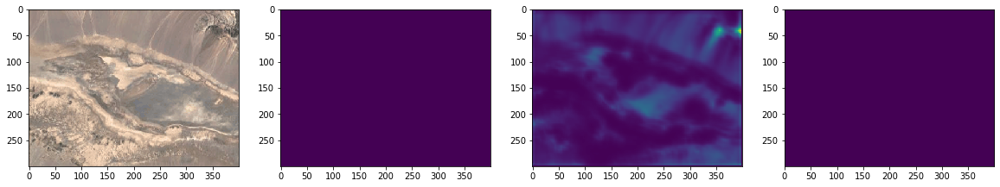

In [56]:
show_all(2)

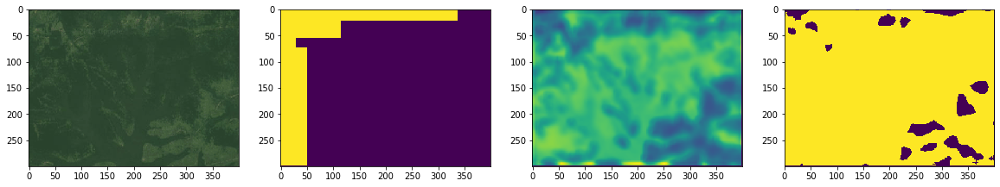

In [57]:
show_all(3)

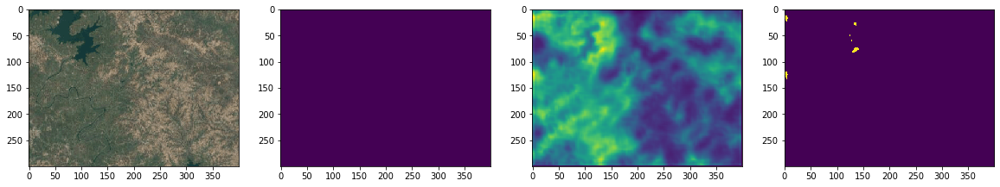

In [58]:
show_all(4)

In [59]:
x, y = validation_generator_satellite_wood.__getitem__(7)

pred = autoencoder.predict(x)

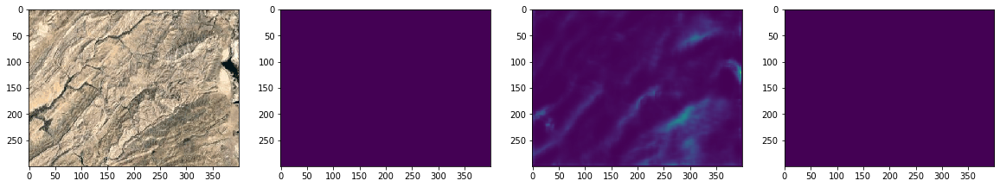

In [60]:
show_all(0)

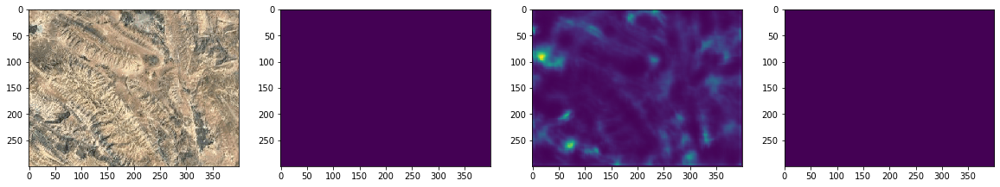

In [61]:
show_all(1)

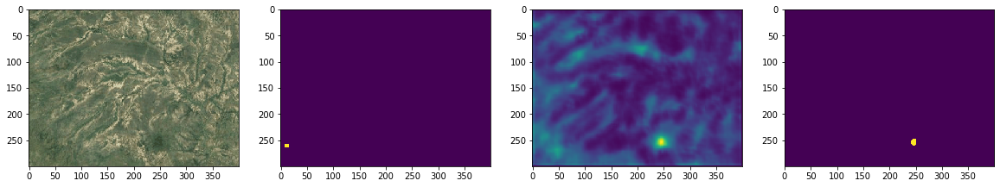

In [62]:
show_all(2)

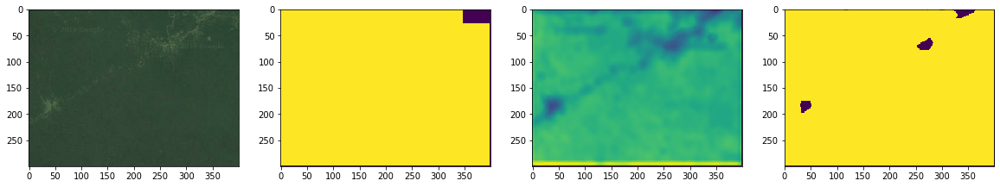

In [63]:
show_all(3)

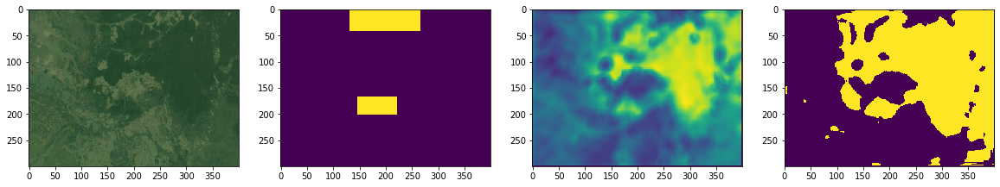

In [64]:
show_all(4)

### valley

In [66]:
autoencoder = load_model(os.path.join('AUTOENCODER_MODEL/', 'best_model_valley_satellite.h5'))

In [93]:
x, y = validation_generator_satellite_valley.__getitem__(1)

pred = autoencoder.predict(x)

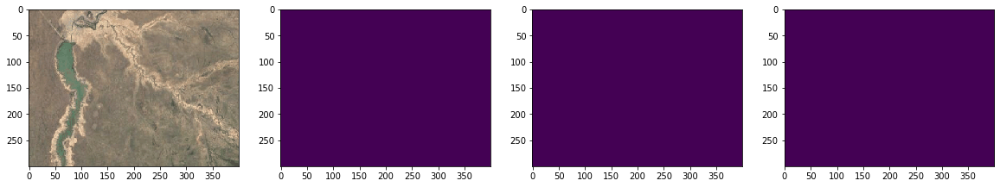

In [94]:
show_all(0)

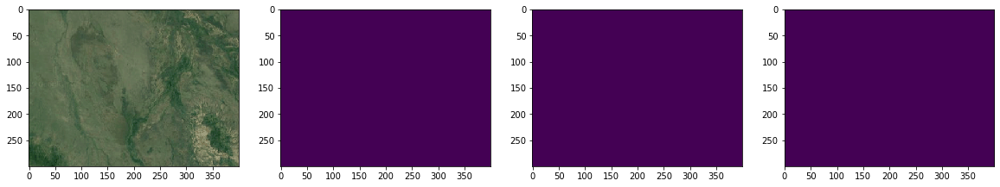

In [95]:
show_all(1)

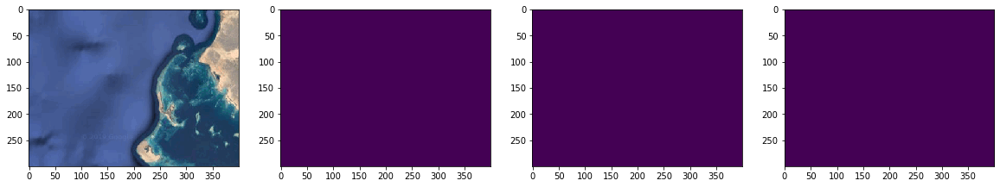

In [96]:
show_all(2)

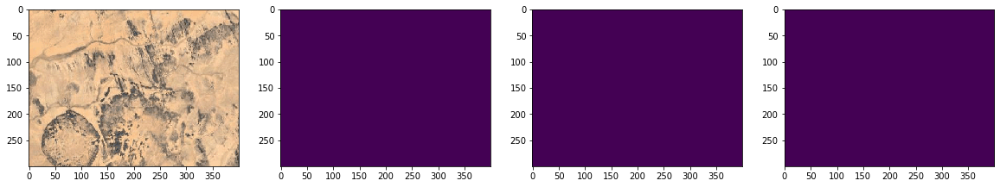

In [97]:
show_all(3)

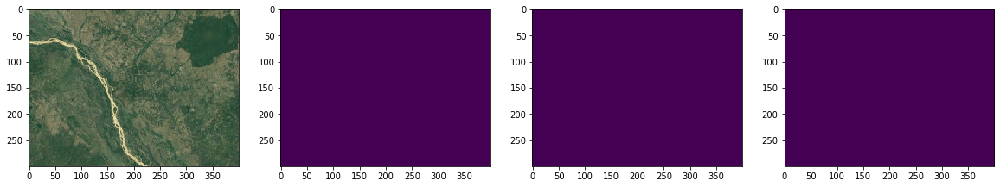

In [98]:
show_all(4)

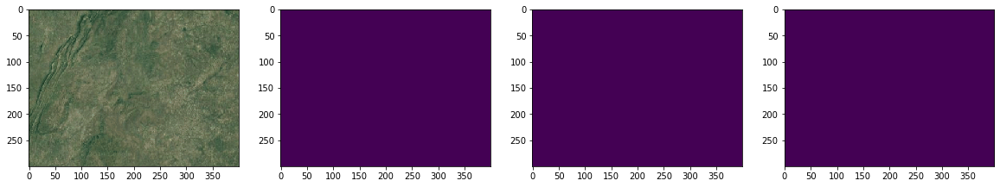

In [99]:
show_all(5)

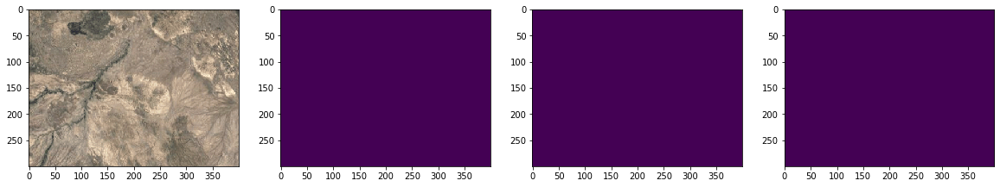

In [100]:
show_all(6)

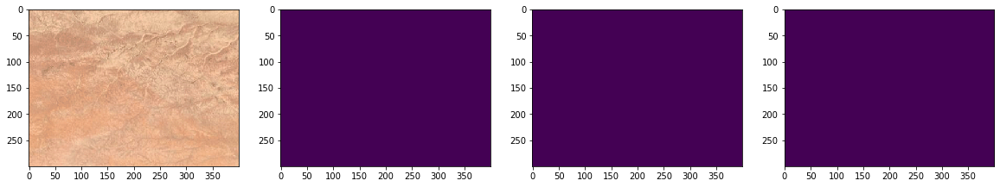

In [101]:
show_all(7)

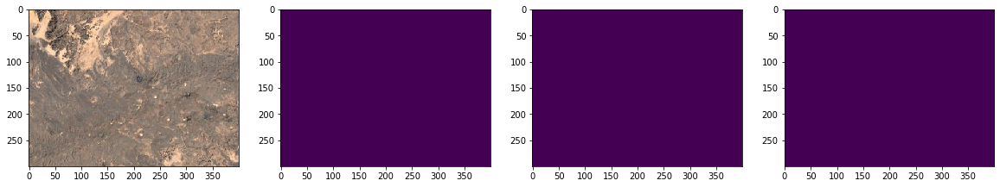

In [102]:
show_all(8)

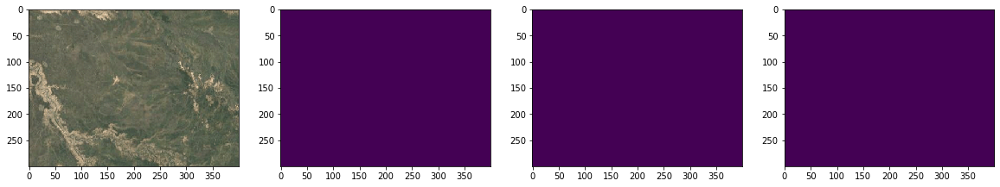

In [103]:
show_all(9)

In [161]:
x, y = validation_generator_satellite_valley.__getitem__(7)

pred = autoencoder.predict(x)

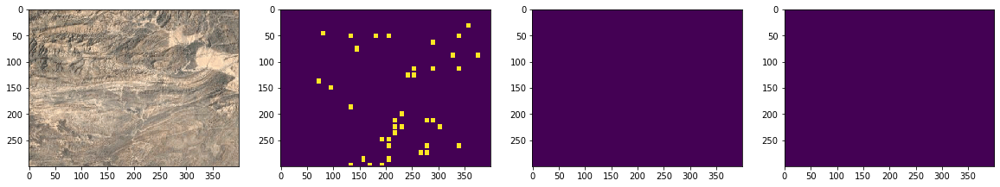

In [168]:
show_all(6)

In [183]:
x, y = validation_generator_satellite_valley.__getitem__(9)

pred = autoencoder.predict(x)

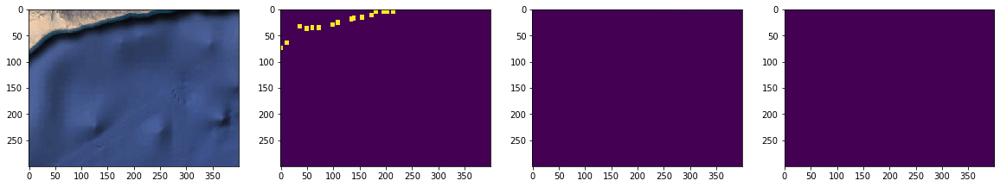

In [188]:
show_all(4)

In [194]:
x, y = validation_generator_satellite_valley.__getitem__(10)

pred = autoencoder.predict(x)

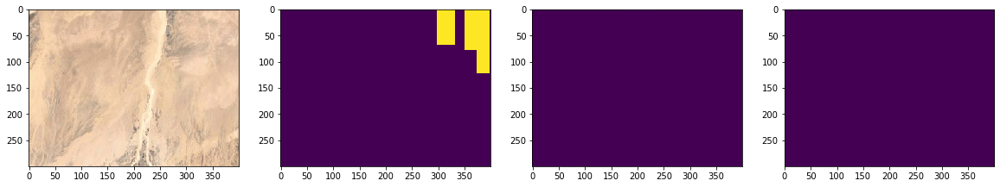

In [205]:
show_all(7)

In [272]:
x, y = validation_generator_satellite_valley.__getitem__(17)

pred = autoencoder.predict(x)

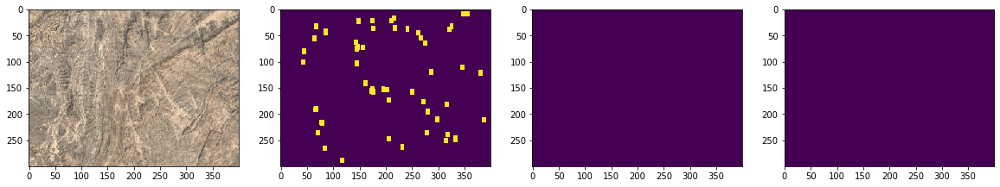

In [278]:
show_all(5)

In [338]:
x, y = validation_generator_satellite_valley.__getitem__(23)

pred = autoencoder.predict(x)

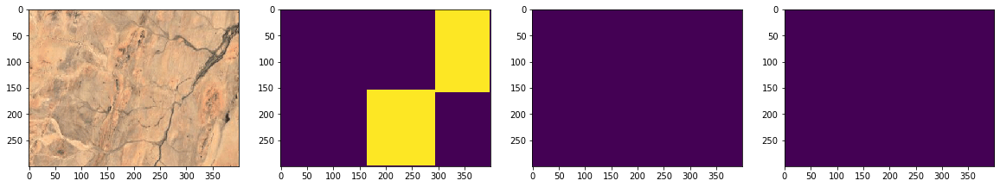

In [339]:
show_all(0)

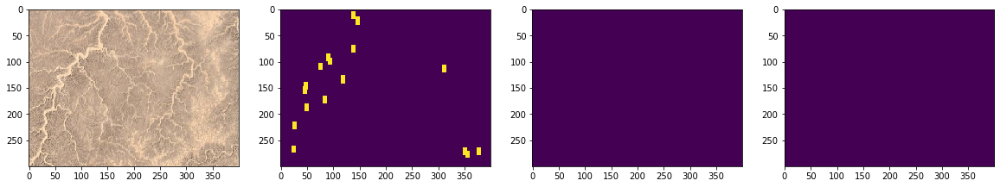

In [347]:
show_all(8)

**Долины предсказать не получилось?**

In [356]:
for i in range(500):
    x, y = validation_generator_satellite_valley.__getitem__(i)
    pred = autoencoder.predict(x)
    
    for j in range(10):
        if np.sum(pred[j] >= 0.15) > 10:
            print("Hey!")
            print(i, j)
            
            show_all(j)


Да, ничего особенно не предсказалось. Но это и понятно, почему. По разметке совершенно не ясно, что из себя представлять должны эти долины, да и очень мало их в исходных данных.

### peak

In [357]:
autoencoder = load_model(os.path.join('AUTOENCODER_MODEL/', 'best_model_peak_satellite.h5'))

In [498]:
def show_all(i, thresh=0.15):
    plt.figure(figsize=(20, 25))

    plt.subplot(141)
    plt.imshow(np.stack([x[i][:,:,2], x[i][:,:,1], x[i][:,:,0]], axis=2))

    plt.subplot(142)
    plt.imshow(y[i].reshape((300, 400)))

    plt.subplot(143)
    plt.imshow(pred[i].reshape((300, 400)))

    plt.subplot(144)
    plt.imshow(pred[i].reshape((300, 400)) >= thresh)

    plt.show()

Hey!
1 4


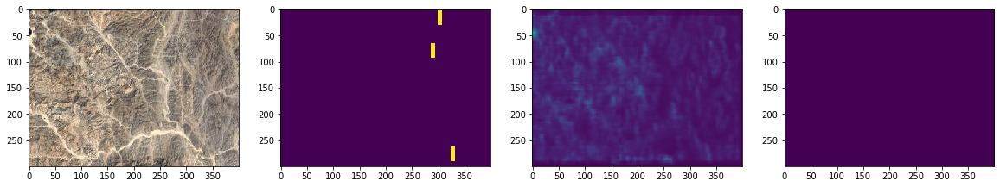

Hey!
4 6


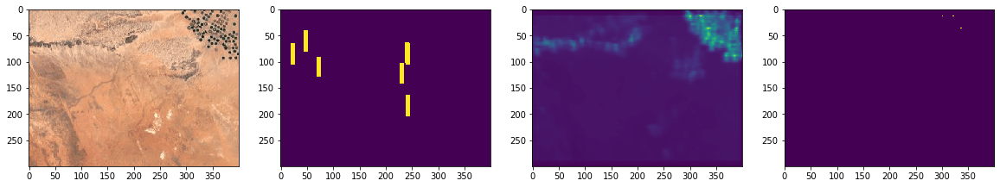

Hey!
4 8


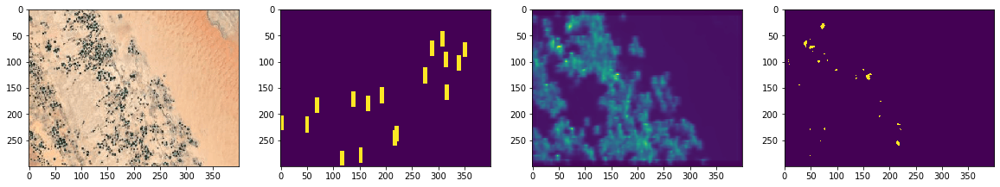

Hey!
6 8


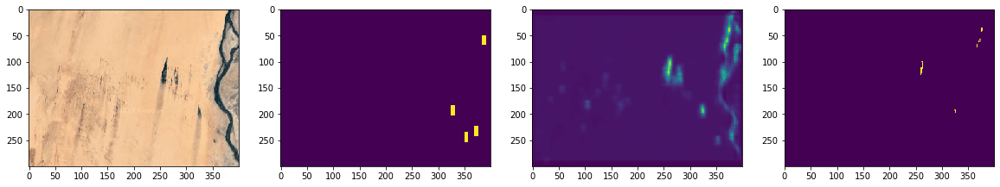

Hey!
8 0


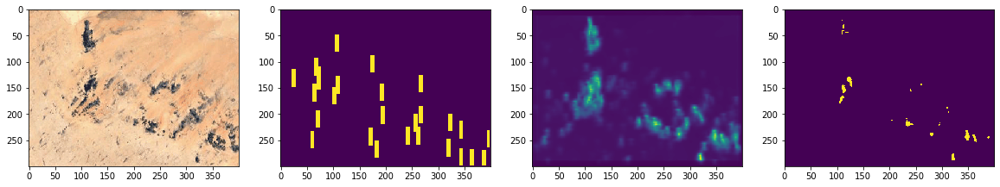

Hey!
8 8


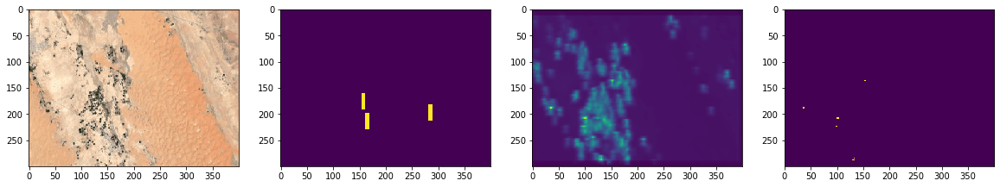

Hey!
10 0


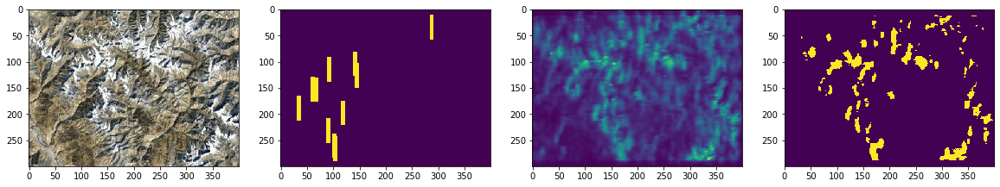

Hey!
10 1


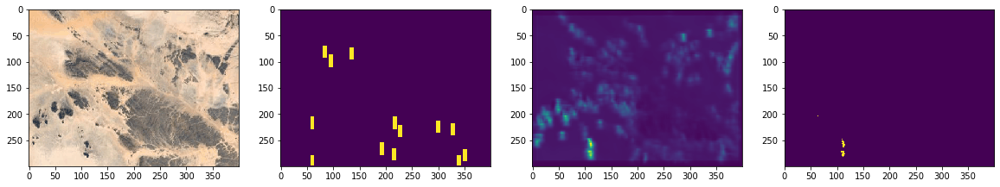

Hey!
10 3


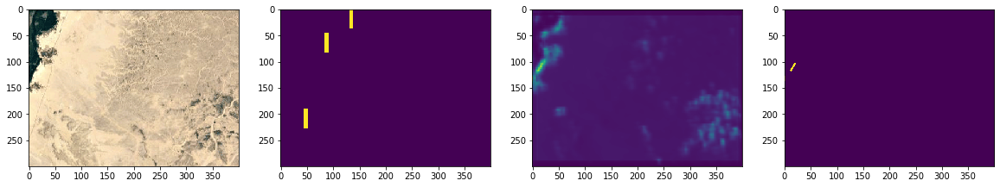

Hey!
11 4


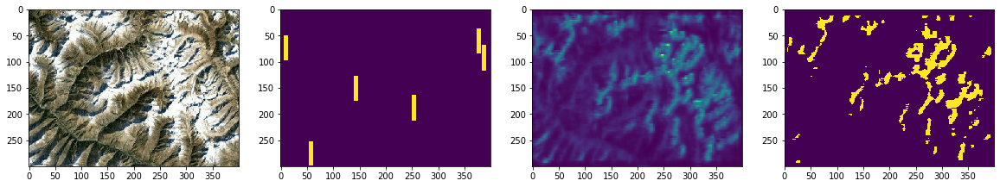

Hey!
11 7


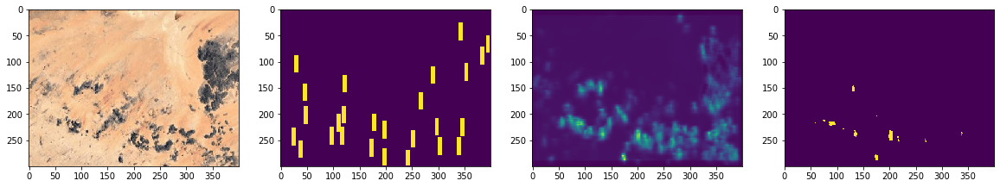

Hey!
12 0


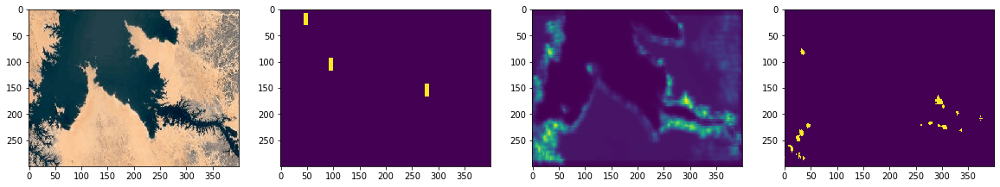

Hey!
12 2


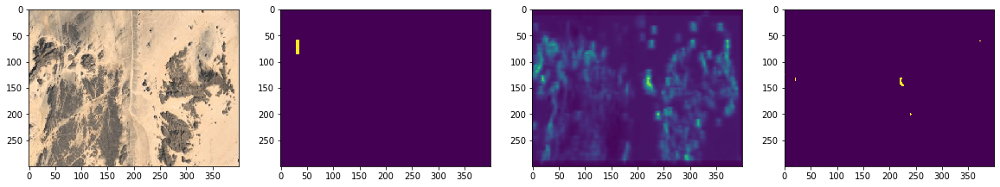

Hey!
13 4


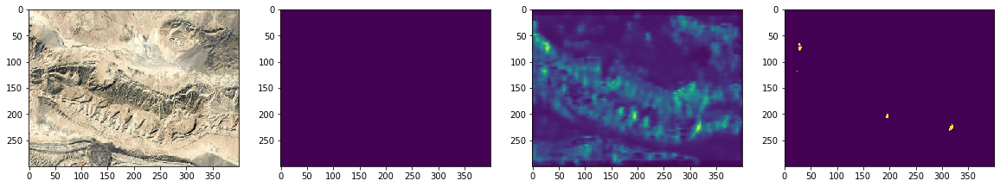

Hey!
14 4


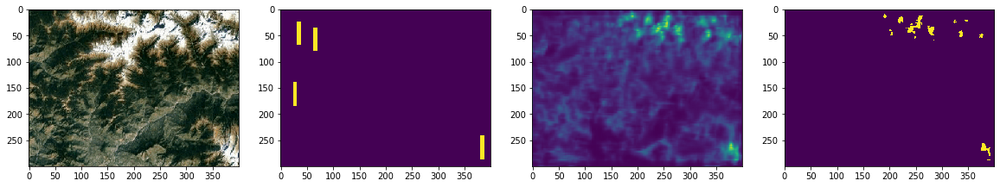

Hey!
26 2


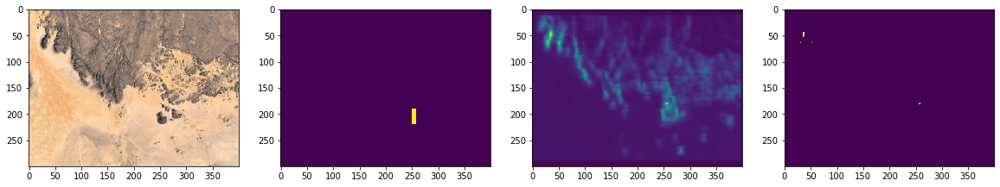

Hey!
26 9


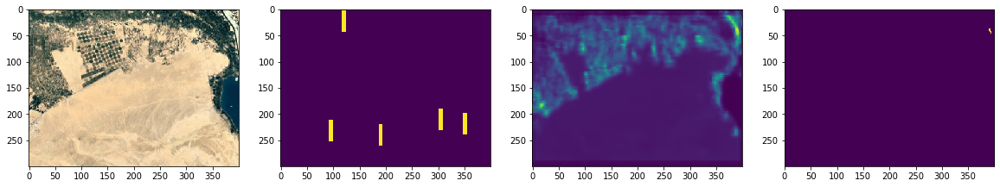

Hey!
28 1


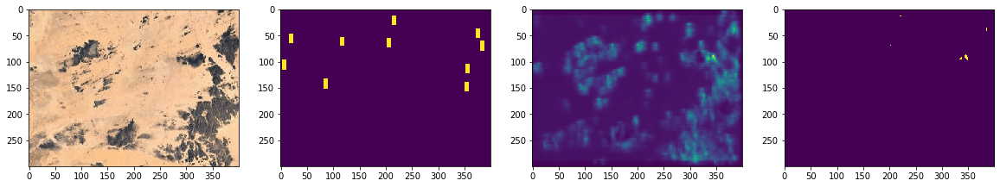

Hey!
29 0


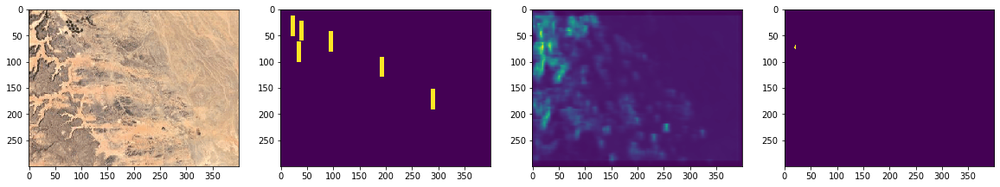

Hey!
29 9


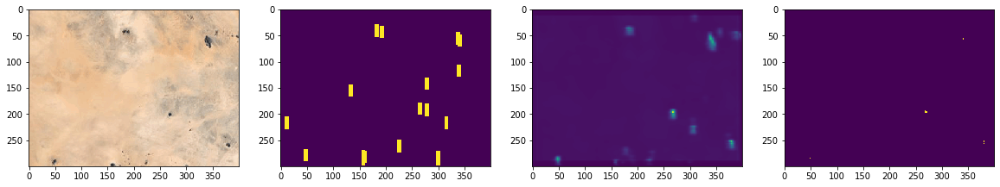

Hey!
30 7


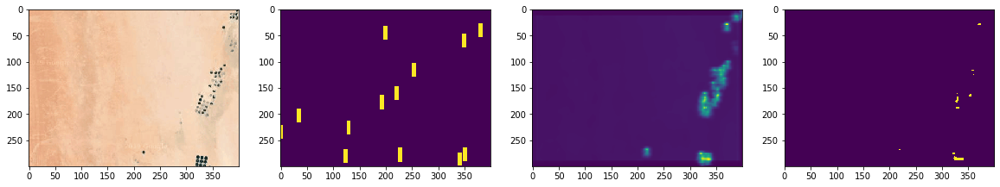

Hey!
31 7


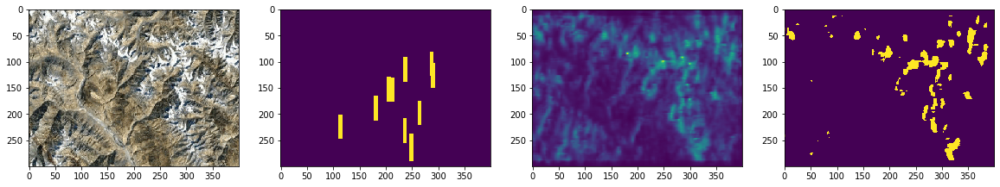

Hey!
32 2


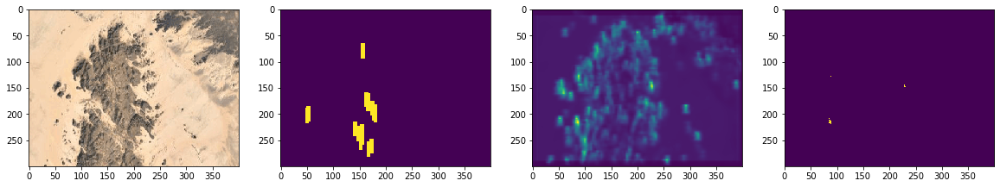

Hey!
33 1


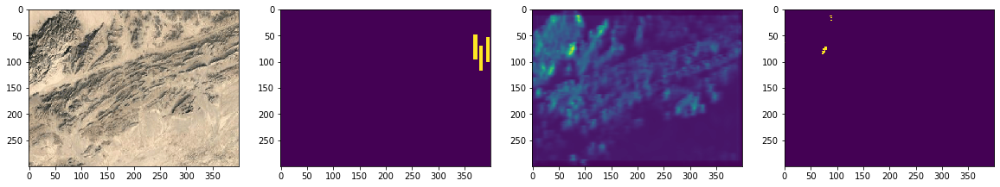

Hey!
34 1


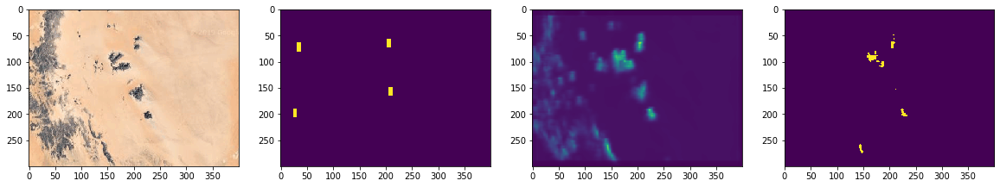

Hey!
34 5


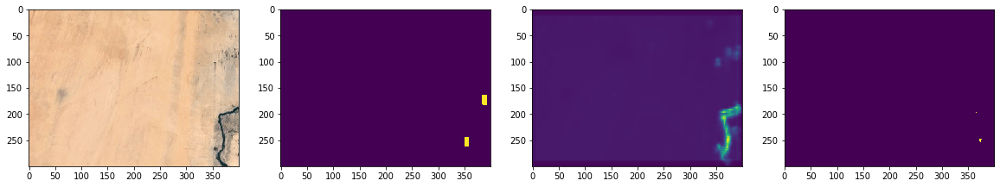

Hey!
35 0


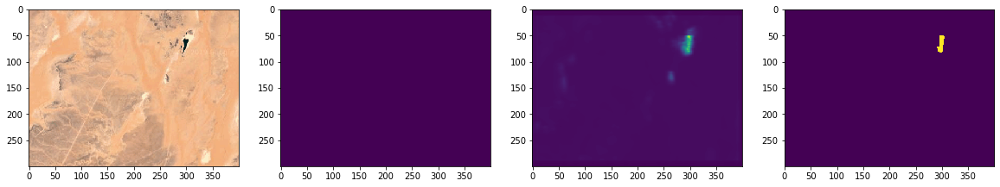

Hey!
40 4


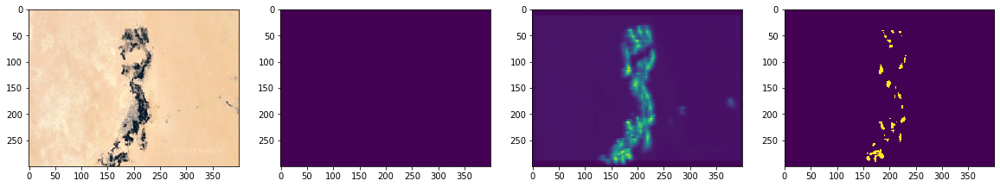

Hey!
42 5


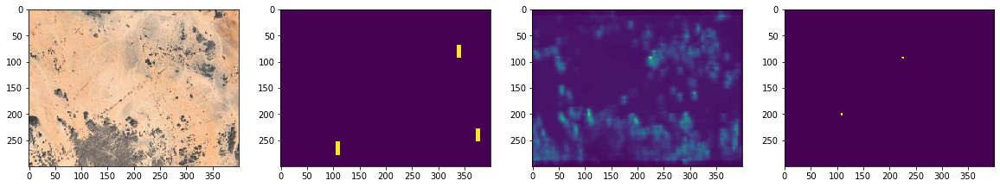

Hey!
44 7


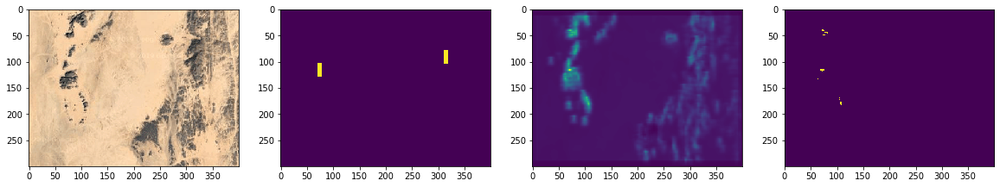

Hey!
45 4


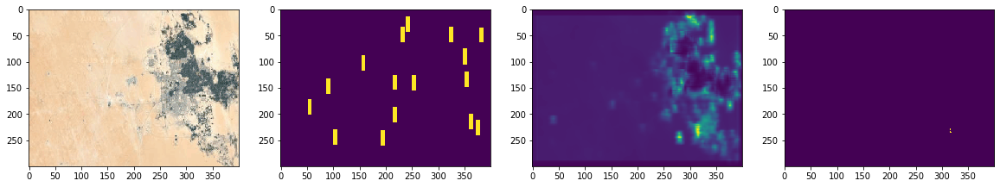

Hey!
45 7


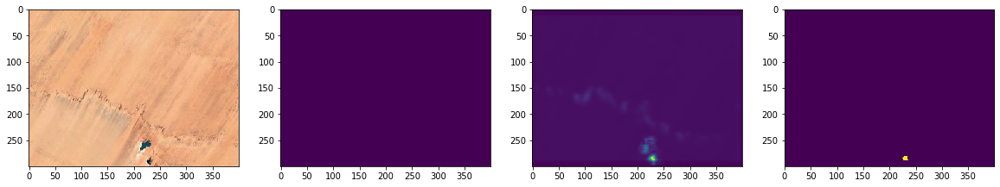

Hey!
47 4


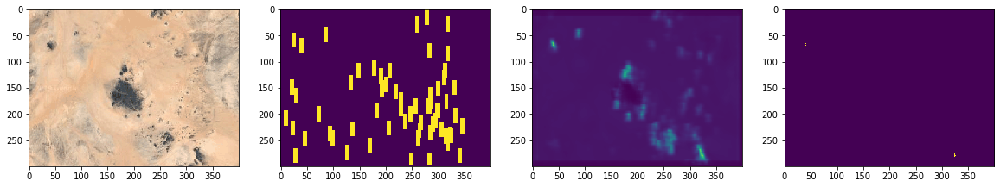

Hey!
47 9


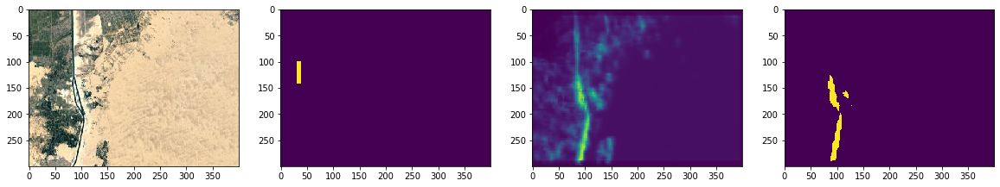

Hey!
48 1


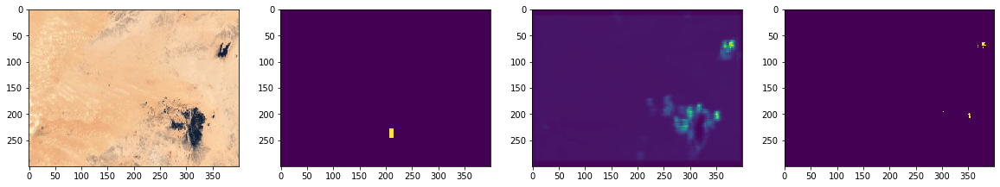

Hey!
48 5


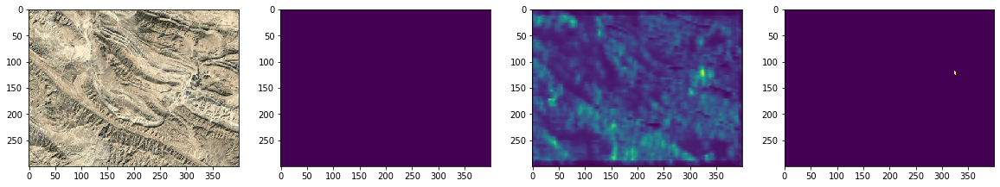

Hey!
49 1


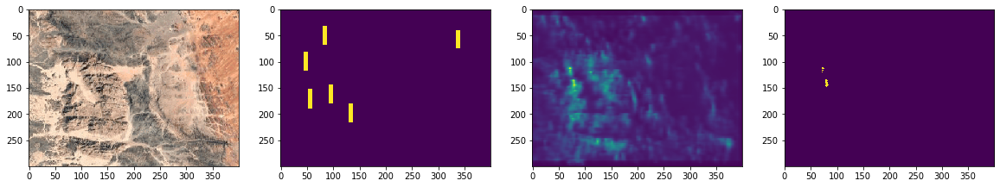

Hey!
51 0


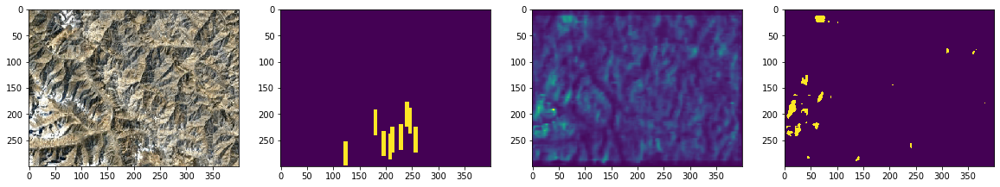

Hey!
53 7


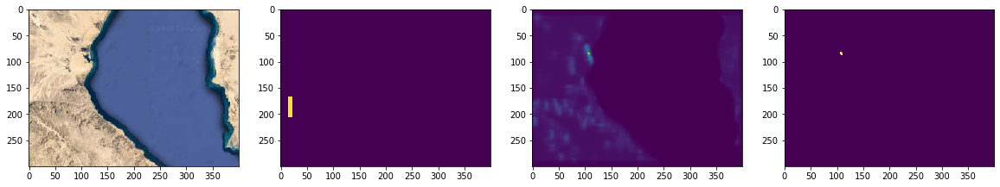

Hey!
55 0


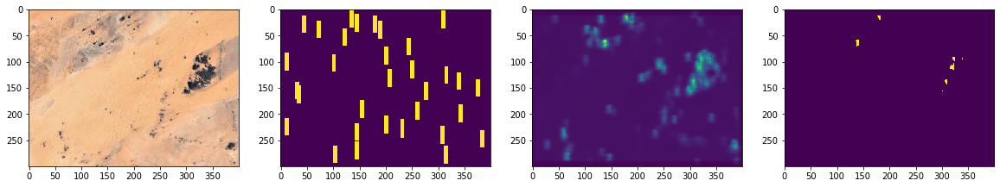

Hey!
55 8


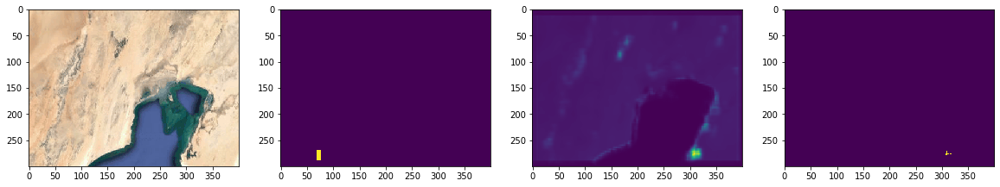

Hey!
58 5


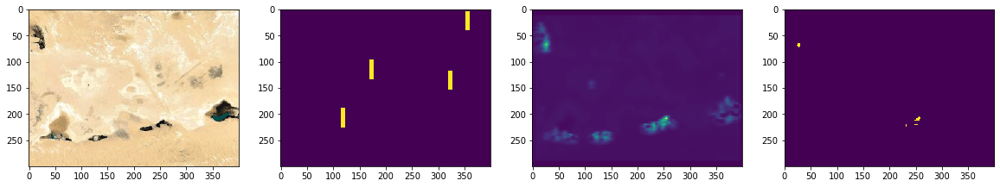

Hey!
58 7


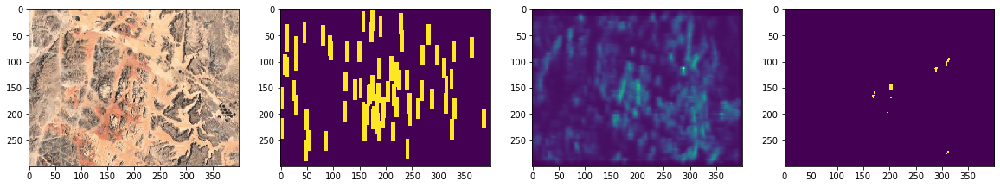

Hey!
60 6


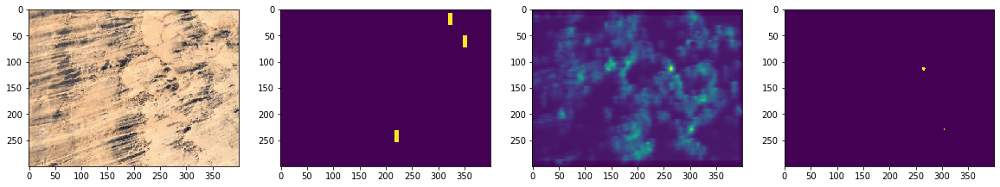

Hey!
61 7


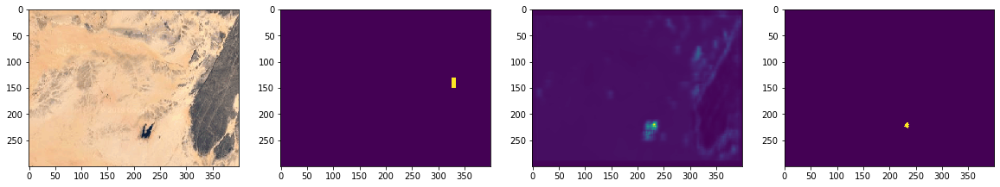

Hey!
67 4


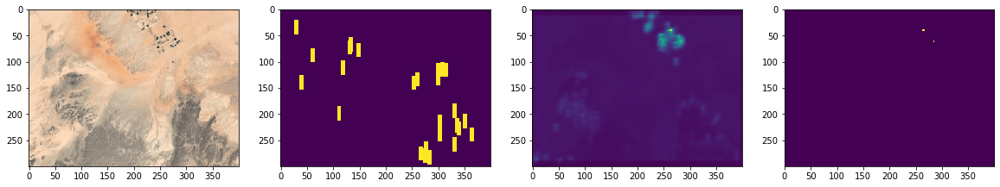

Hey!
67 6


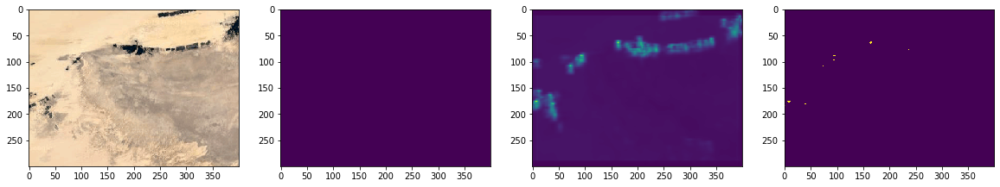

Hey!
67 7


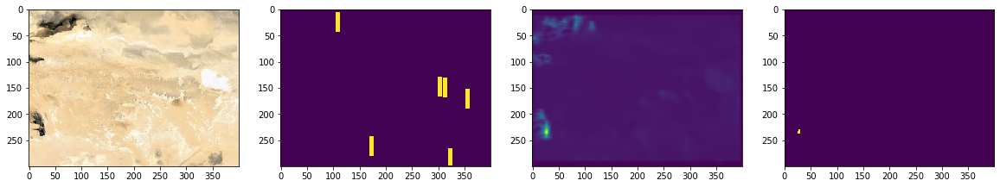

Hey!
73 7


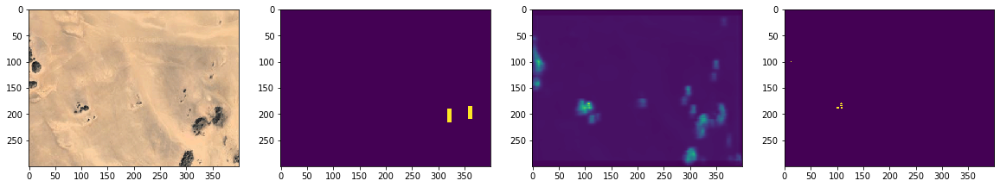

Hey!
75 2


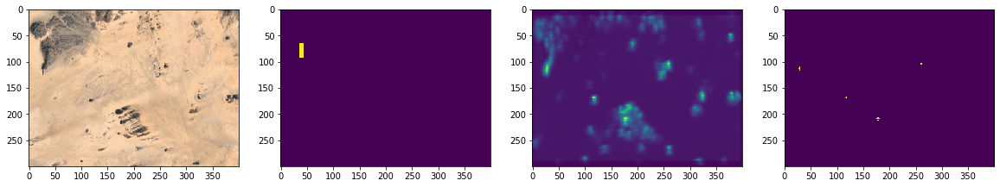

Hey!
75 7


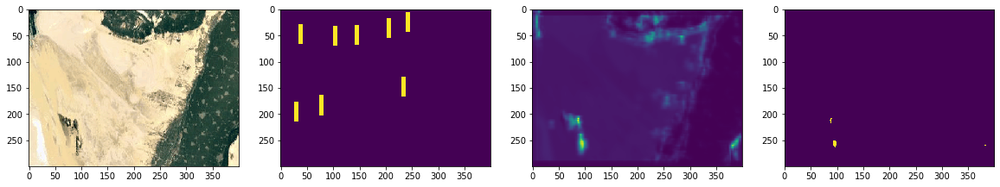

Hey!
76 4


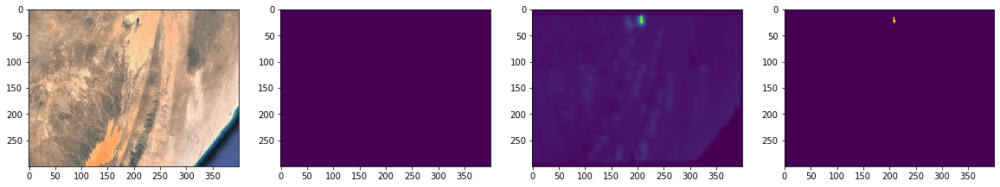

Hey!
78 4


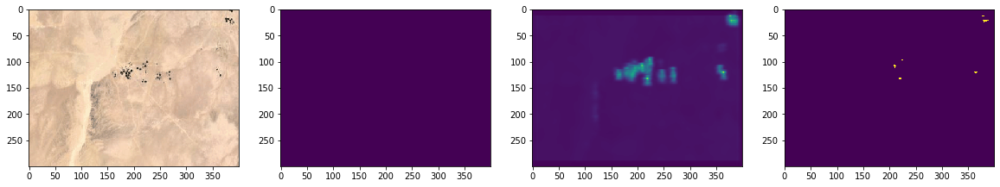

Hey!
78 5


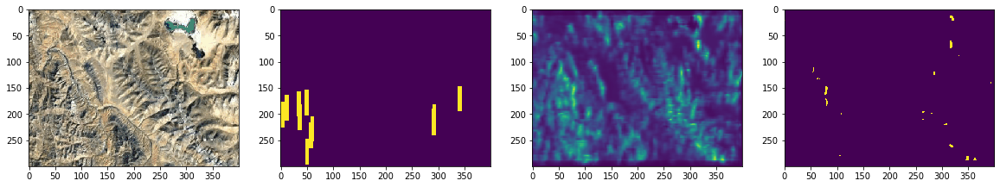

Hey!
80 0


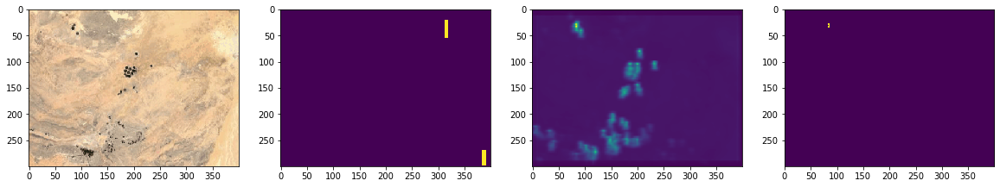

Hey!
81 9


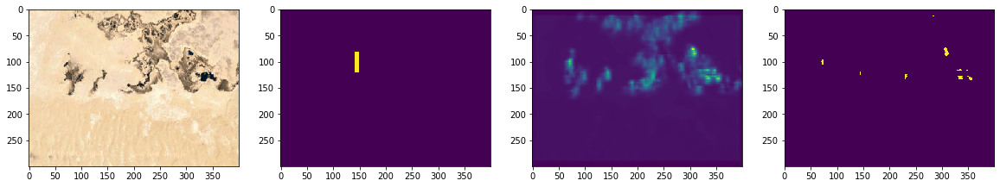

Hey!
82 7


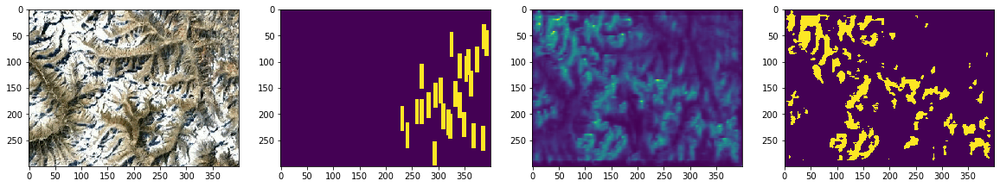

Hey!
83 3


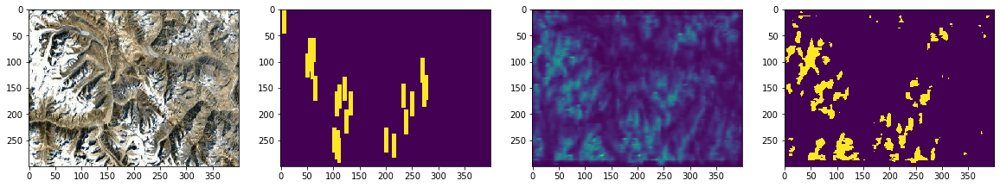

Hey!
84 0


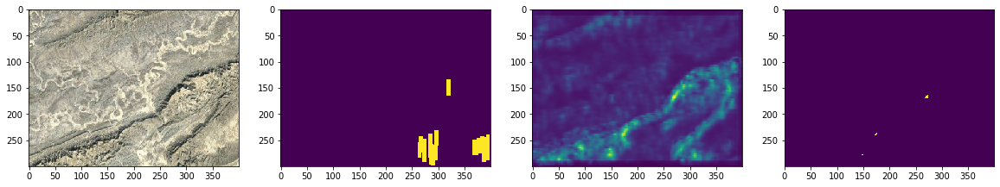

Hey!
84 9


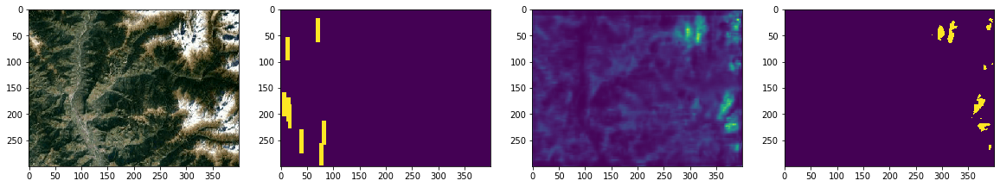

Hey!
85 9


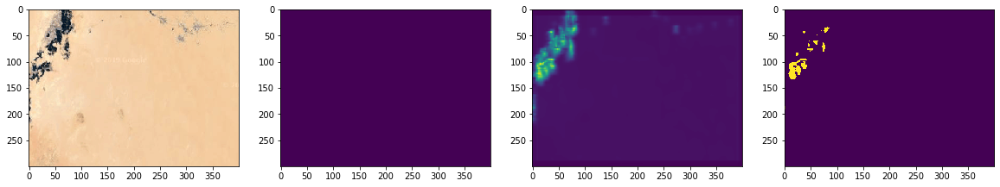

Hey!
87 3


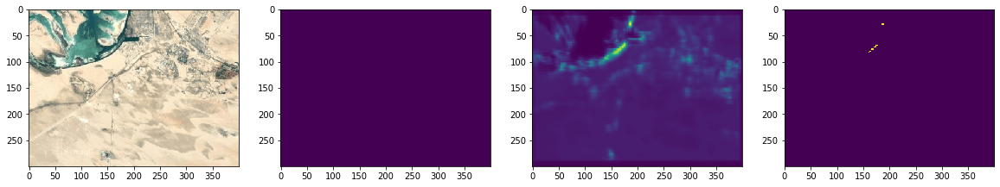

Hey!
88 7


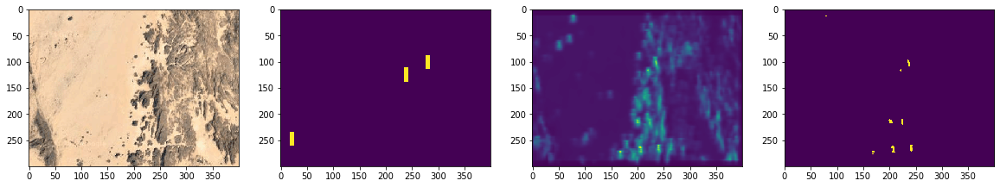

Hey!
89 4


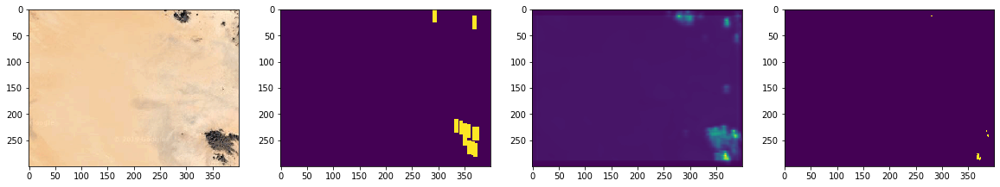

Hey!
91 1


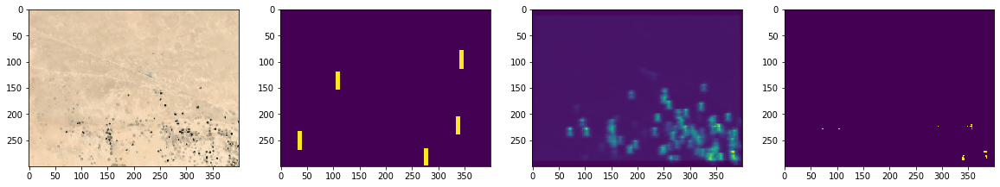

Hey!
91 4


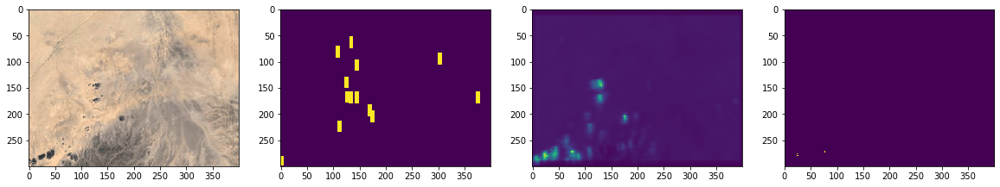

Hey!
91 5


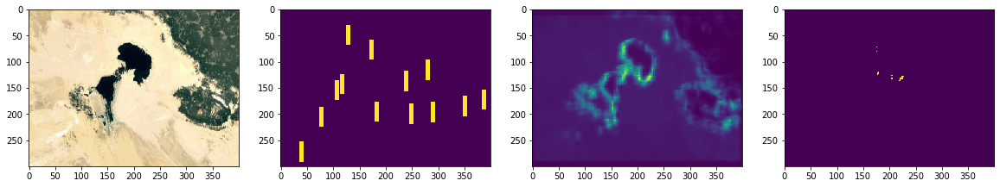

Hey!
95 0


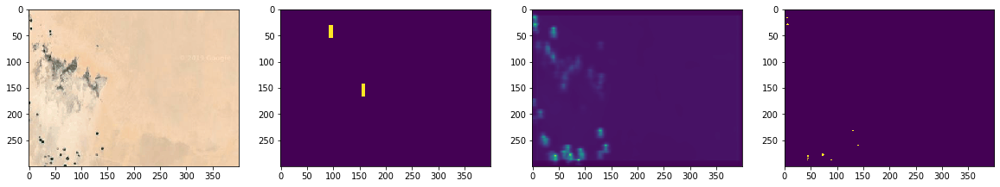

Hey!
96 6


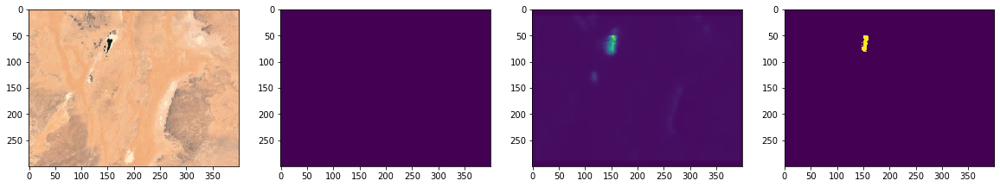

Hey!
97 2


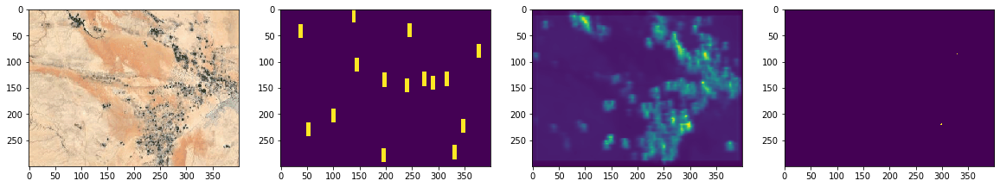

Hey!
97 4


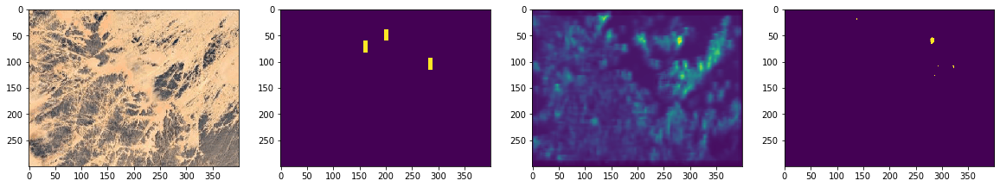

Hey!
98 5


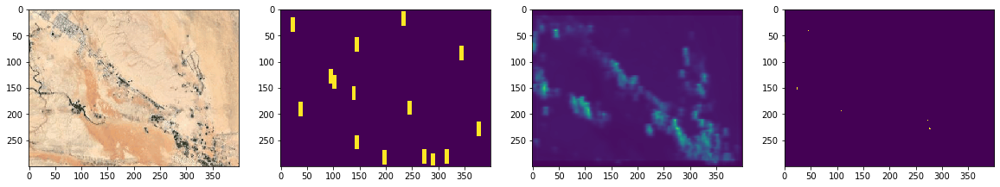

Hey!
103 7


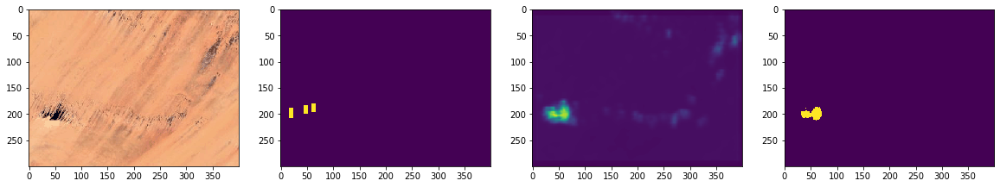

Hey!
103 9


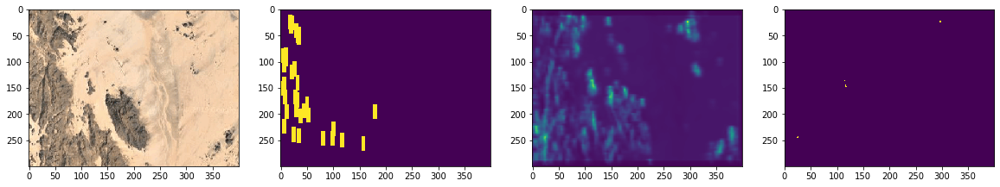

Hey!
105 0


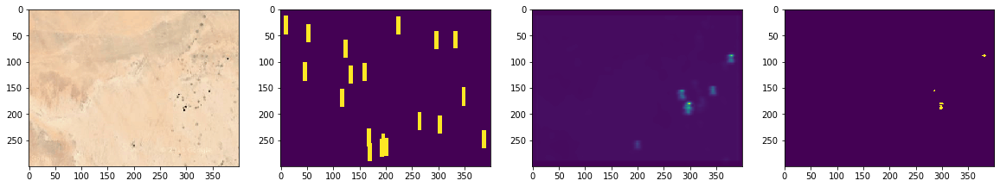

Hey!
106 3


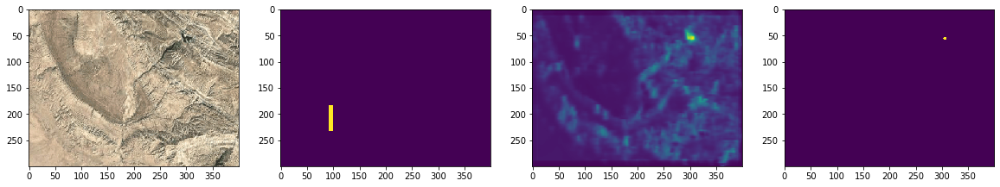

Hey!
106 8


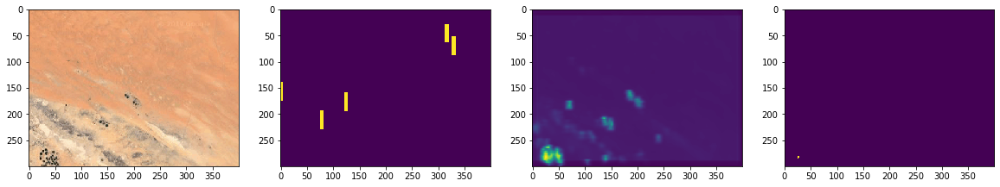

KeyboardInterrupt: 

In [497]:
for i in range(500):
    x, y = validation_generator_satellite_peak.__getitem__(i)
    pred = autoencoder.predict(x)
    
    for j in range(10):
        if np.sum(pred[j] >= 0.08) > 10:
            print("Hey!")
            print(i, j)
            
            show_all(j, thresh=0.08)


In [499]:
x, y = validation_generator_satellite_peak.__getitem__(0)

pred = autoencoder.predict(x)

In [500]:
PEAK_THRESH = 0.08

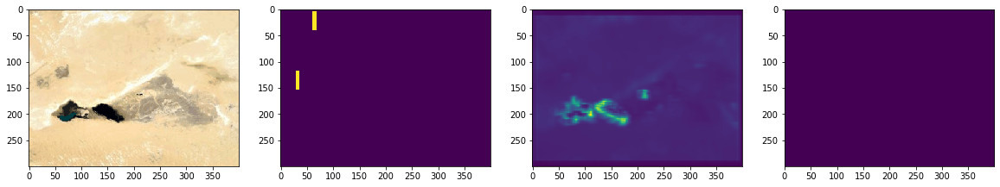

In [501]:
show_all(0, PEAK_THRESH)

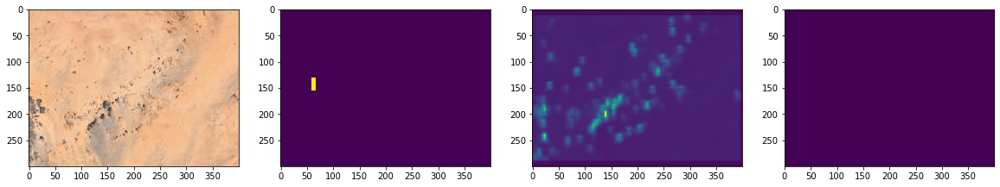

In [502]:
show_all(1, PEAK_THRESH)

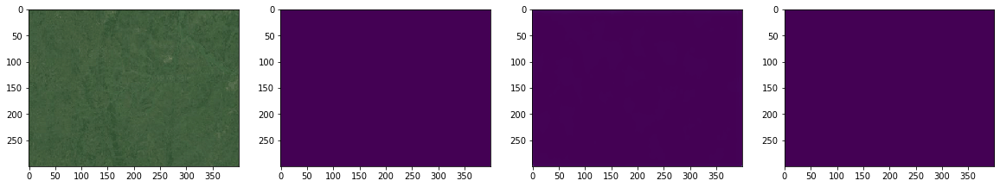

In [503]:
show_all(2, PEAK_THRESH)

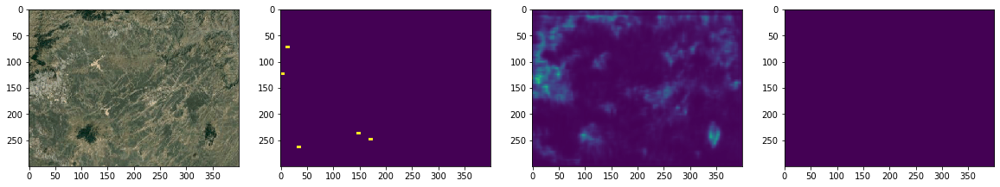

In [504]:
show_all(3, PEAK_THRESH)

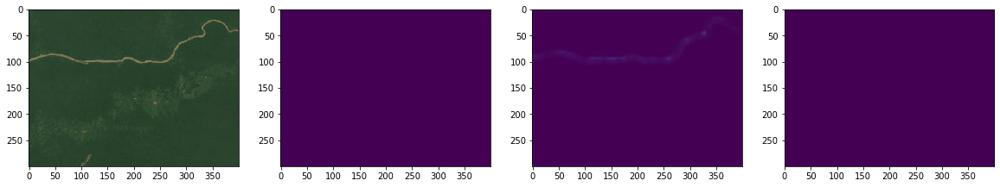

In [505]:
show_all(4, PEAK_THRESH)

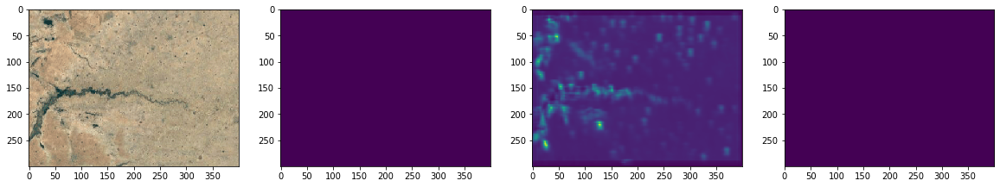

In [506]:
show_all(5, PEAK_THRESH)

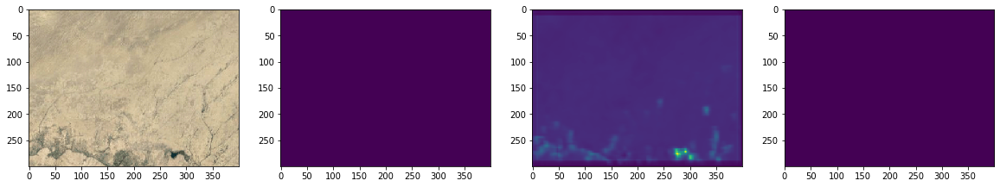

In [507]:
show_all(6, PEAK_THRESH)

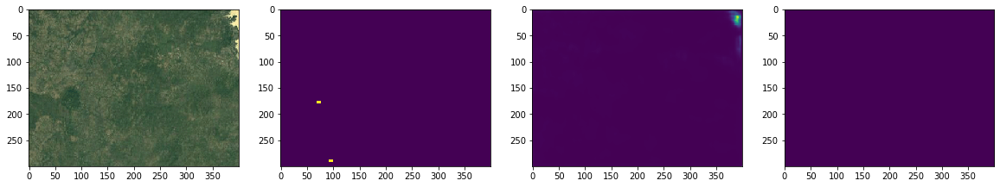

In [508]:
show_all(7, PEAK_THRESH)

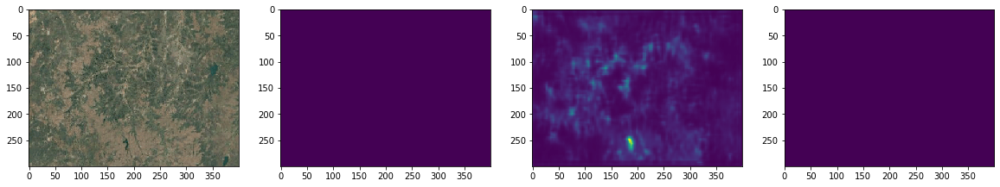

In [509]:
show_all(8, PEAK_THRESH)

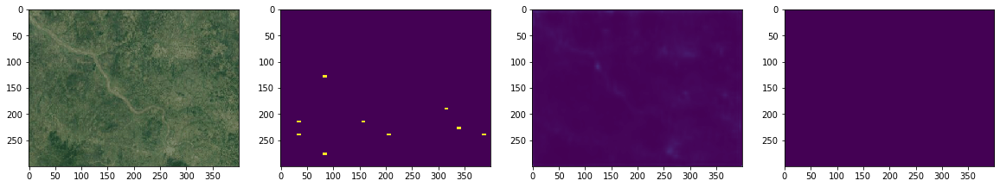

In [510]:
show_all(9, PEAK_THRESH)

### ridge

In [511]:
autoencoder = load_model(os.path.join('AUTOENCODER_MODEL/', 'best_model_ridge_satellite.h5'))

Hey!
12 3


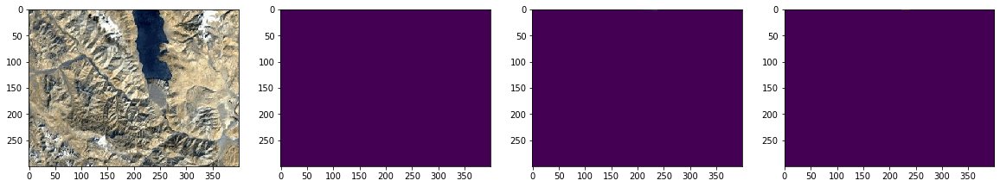

Hey!
13 9


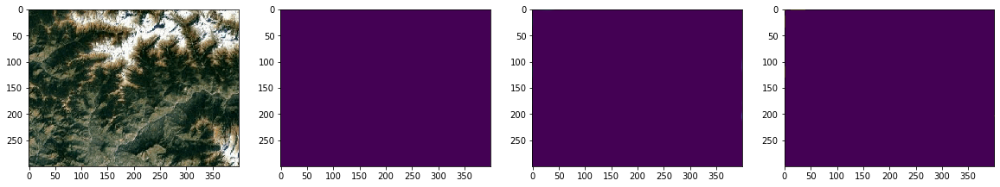

Hey!
20 6


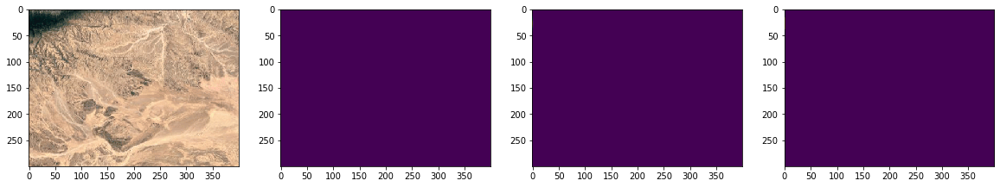

Hey!
28 2


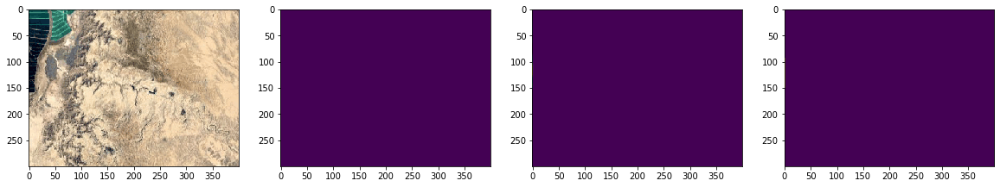

Hey!
30 1


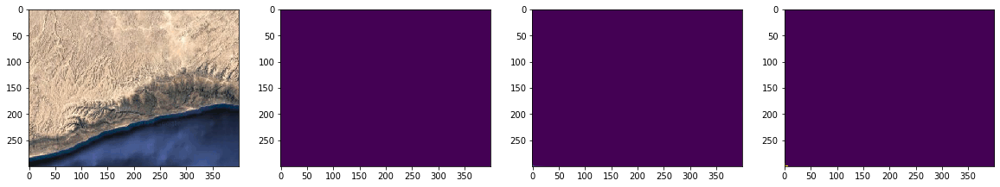

Hey!
30 5


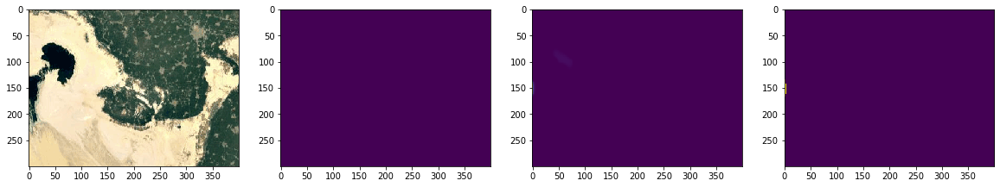

Hey!
47 1


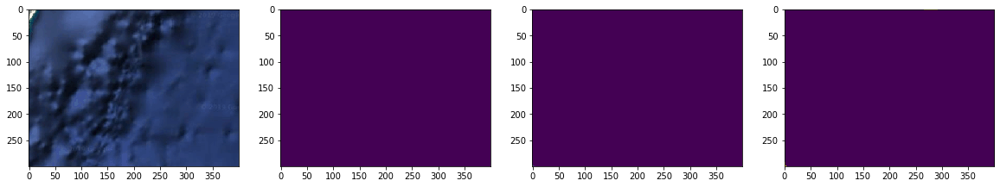

Hey!
66 2


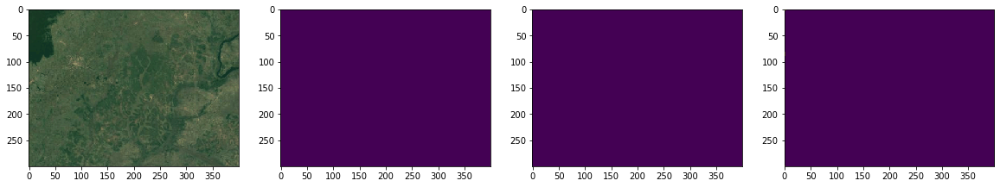

Hey!
67 0


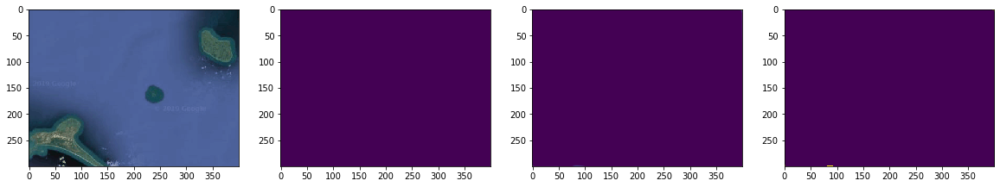

Hey!
73 2


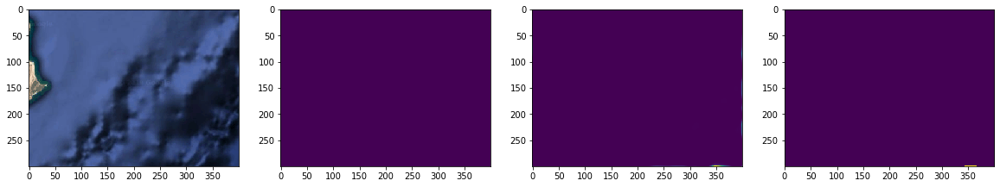

In [515]:
for i in range(100):
    x, y = validation_generator_satellite_ridge.__getitem__(i)
    pred = autoencoder.predict(x)
    
    for j in range(10):
        if np.sum(pred[j] >= 0.02) > 10:
            print("Hey!")
            print(i, j)
            
            show_all(j, thresh=0.02)


С хребтами как-то тоже не очень получилось. Как с долинами.

Нормальные предсказания получились для **леса, воды и пиков (более-менее)**